# A Tail of Breeds: Unleashing the Power of AI in Dog Breed **Classification** !

# Introduction to Animal Breed Classification
Importance of Animal Breed Classification
Animal breed classification plays a crucial role in various fields, including agriculture, veterinary science, and
biology.
# It helps in:
### Breeding Programs:
 Identifying ideal
breeding pairs to enhance desirable traits.
###Healthcare:
Tailoring healthcare
plans based on breed-specific health risks.
###Nutrition:
 Designing specialized diets suited to different breeds' nutritional needs.
###Behavior and Training:
Understanding breed-specific behaviors for effective training.
###Research and Conservation:
 Studying genetic diversity and aiding in conservation efforts.
#Challenges in Animal Breed Classification
###Classifying animal breeds based on visual characteristics poses several challenges, such as:

###Similarities:
 Many breeds share similar physical features, making differentiation difficult.
###Variability:
 Individual variation within breeds can make it challenging to establish breed standards.
###Data Collection:
 Gathering a diverse and representative dataset of images for training can be labor-intensive.
###Complex Features:
 Some breed-defining characteristics may be subtle or context-dependent, requiring sophisticated algorithms to detect.

#**Technologies and Libraries Used**
##Deep Learning Frameworks:

###**PyTorch**:
 Used for building, training, and evaluating deep learning models.
###**TensorFlow**:
 Utilized for processing images and implementing deep learning algorithms.
##**Model Architectures:**

###EfficientNet:
 Experimented with for its efficiency and effectiveness in image classification tasks.
###Vision Transformer (ViT):
 Explored for its unique approach to processing images using transformer architectures.
###MobileNet:
 Tested for its lightweight architecture suitable for mobile and embedded devices.
###EfficientFormer:
 Investigated for its hybrid architecture combining transformer and convolutional layers.
#**Data Processing and Augmentation:**

###pandas:
 Used for data manipulation and analysis, including reading CSV files containing breed labels.
###NumPy:
 Utilized for array manipulation and mathematical operations.
###torchvision.transforms:
 Applied for image preprocessing and augmentation to enhance dataset diversity.
#**Data Handling and Visualization:**

###PIL (Python Imaging Library):
 Used for image loading, resizing, and transformation.
###Matplotlib:
 Utilized for data visualization, including plotting images and performance metrics.
###tqdm:
 Employed for displaying progress bars during data processing and training.
#**Model Evaluation and Optimization:**

###torch.utils.data.Dataset:
 Implemented for custom dataset creation and handling.
###torch.utils.data.DataLoader:
 Used for batch processing and shuffling of data.
###torch.optim:
 Utilized for model optimization using the Adam optimizer.
###torch.nn.CrossEntropyLoss:
 Applied as the loss function for multi-class classification tasks.
#**Model** Analysis and Interpretation:

###torchinfo:
 Used for model summary and analysis, including input/output shapes and number of parameters.
###TensorBoard:
 Utilized for visualizing model training and evaluation metrics, including loss and accuracy curves.
#**Environment and Infrastructure:**

###Google Colab:
 Used as the primary development environment for running code and training models, providing GPU acceleration.
###Kaggle:
 Data source for the dataset containing images of different dog breeds, facilitating access to a large and diverse dataset.
#**Additional Libraries:**

###scikit-learn:
 Used for various machine learning tasks, such as data splitting and model evaluation (e.g., train_test_split function).
###random:
 Employed for setting random seeds to ensure reproducibility in model training.
###os:
 Utilized for directory handling and file operations, including checking the number of images in a directory.
###torch.cuda:
 Used for checking GPU availability and setting the device for model training.
torch.manual_seed and torch.cuda.
###manual_seed:
 Utilized for setting random seeds for reproducibility in model training.


---


These technologies and libraries were instrumental in developing and evaluating the animal breed classification models, enabling efficient data processing, model training, and performance analysis.

#Here i am going to make this project by using PYTorch liberary, where i will try to replicate the research paper of vision transformer

#Data Collection and Preprocessing:

source-kaggle- https://www.kaggle.com/datasets/jessicali9530/stanford-dogs-dataset

In [9]:
import torch
from torch import nn
import pandas as pd

device agnostic code, where if we are luckey we will get the power of one of colab gpu "cuda"(if we dont pay for the premium then mostly we will gonna be unluckey:(...)

In [10]:
device= "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

process of data collection

#the data is in the below format
Dog_vision

*   test // containing test image files
*   train // containing train image files


*   label.csv // containing target labels









In [11]:
label_csv_path = r'C:\Users\Inzayn\Downloads\dog-breed-identification\labels.csv'


In [12]:
import torchinfo

In [13]:
import pandas as pd
labels= pd.read_csv(label_csv_path)

In [14]:
labels[:10]

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever
5,002211c81b498ef88e1b40b9abf84e1d,bedlington_terrier
6,00290d3e1fdd27226ba27a8ce248ce85,bedlington_terrier
7,002a283a315af96eaea0e28e7163b21b,borzoi
8,003df8b8a8b05244b1d920bb6cf451f9,basenji
9,0042188c895a2f14ef64a918ed9c7b64,scottish_deerhound


In [15]:
breeds= labels["breed"]

In [16]:
breeds[:10]

0           boston_bull
1                 dingo
2              pekinese
3              bluetick
4      golden_retriever
5    bedlington_terrier
6    bedlington_terrier
7                borzoi
8               basenji
9    scottish_deerhound
Name: breed, dtype: object

In [17]:
train_image_path=r"C:\Users\Inzayn\Downloads\dog-breed-identification\train"
test_image_path= r"C:\Users\Inzayn\Downloads\dog-breed-identification\test"
train_image_path

'C:\\Users\\Inzayn\\Downloads\\dog-breed-identification\\train'

In [18]:
import os

In [19]:
len(os.listdir(test_image_path))

10357

In [20]:
unique_breeds= breeds.unique()

In [21]:
labels["id"]

0        000bec180eb18c7604dcecc8fe0dba07
1        001513dfcb2ffafc82cccf4d8bbaba97
2        001cdf01b096e06d78e9e5112d419397
3        00214f311d5d2247d5dfe4fe24b2303d
4        0021f9ceb3235effd7fcde7f7538ed62
                       ...               
10217    ffd25009d635cfd16e793503ac5edef0
10218    ffd3f636f7f379c51ba3648a9ff8254f
10219    ffe2ca6c940cddfee68fa3cc6c63213f
10220    ffe5f6d8e2bff356e9482a80a6e29aac
10221    fff43b07992508bc822f33d8ffd902ae
Name: id, Length: 10222, dtype: object

In [22]:
import numpy as np
len(unique_breeds)



120

In [23]:
filenames= [r"/Users/Inzayn/Downloads/dog-breed-identification/train/"+fname+".jpg" for fname in labels["id"]]

In [24]:
filenames[:10]

['/Users/Inzayn/Downloads/dog-breed-identification/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/Users/Inzayn/Downloads/dog-breed-identification/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/Users/Inzayn/Downloads/dog-breed-identification/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/Users/Inzayn/Downloads/dog-breed-identification/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/Users/Inzayn/Downloads/dog-breed-identification/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/Users/Inzayn/Downloads/dog-breed-identification/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/Users/Inzayn/Downloads/dog-breed-identification/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/Users/Inzayn/Downloads/dog-breed-identification/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/Users/Inzayn/Downloads/dog-breed-identification/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/Users/Inzayn/Downloads/dog-breed-identification/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [25]:
one_image= filenames[0]

In [26]:
one_image

'/Users/Inzayn/Downloads/dog-breed-identification/train/000bec180eb18c7604dcecc8fe0dba07.jpg'

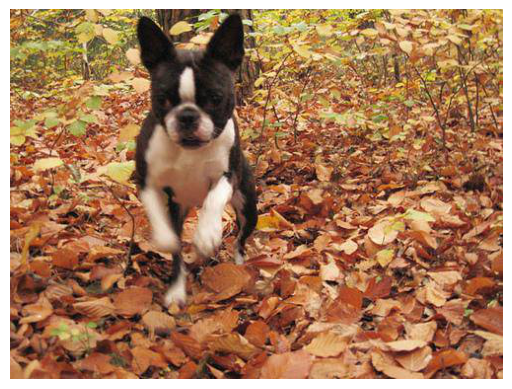

In [27]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

# Load the image file
img = Image.open(one_image)

# Convert the image to a NumPy array
one_image = np.array(img)

# Plot the image
plt.imshow(one_image)
plt.axis('off')  # Turn off axis numbers and ticks
plt.show()


In [34]:
img.shape

AttributeError: 'JpegImageFile' object has no attribute 'shape'

In [35]:
import os
actual=len(os.listdir(r"C:\Users\Inzayn\Downloads\dog-breed-identification\train"))
wehave=len(filenames)
if len(os.listdir(r"C:\Users\Inzayn\Downloads\dog-breed-identification\train"))== len(filenames):
  print("matches acutal amount of data")
else:
  print("do not match"+"actual len="+str(actual)+"and we got"+str(wehave))

matches acutal amount of data


In [36]:
print(breeds[0])

boston_bull


here we are changing the label in boolean

In [37]:
breeds[1]==unique_breeds

array([False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [38]:
boolean_labels= [label == unique_breeds for label in breeds]
boolean_labels[0]

array([ True, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [39]:
import os
def walk_through_dir(dir_path):
  """
  Walks through dir_path returning its contents.
  Args:
    dir_path (str or pathlib.Path): target directory

  Returns:
    A print out of:
      number of subdiretories in dir_path
      number of images (files) in each subdirectory
      name of each subdirectory
  """
  for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")

In [40]:
walk_through_dir(r"C:\Users\Inzayn\Downloads\dog-breed-identification")

There are 2 directories and 2 images in 'C:\Users\Inzayn\Downloads\dog-breed-identification'.
There are 0 directories and 10357 images in 'C:\Users\Inzayn\Downloads\dog-breed-identification\test'.
There are 0 directories and 10222 images in 'C:\Users\Inzayn\Downloads\dog-breed-identification\train'.


In [41]:
len(boolean_labels)

10222

because computer needs a value in the single tensor , so we assighning each single breed to the unique integer

In [42]:
breed_to_num = dict(zip(unique_breeds, range(len(unique_breeds))))
breed_to_num

{'boston_bull': 0,
 'dingo': 1,
 'pekinese': 2,
 'bluetick': 3,
 'golden_retriever': 4,
 'bedlington_terrier': 5,
 'borzoi': 6,
 'basenji': 7,
 'scottish_deerhound': 8,
 'shetland_sheepdog': 9,
 'walker_hound': 10,
 'maltese_dog': 11,
 'norfolk_terrier': 12,
 'african_hunting_dog': 13,
 'wire-haired_fox_terrier': 14,
 'redbone': 15,
 'lakeland_terrier': 16,
 'boxer': 17,
 'doberman': 18,
 'otterhound': 19,
 'standard_schnauzer': 20,
 'irish_water_spaniel': 21,
 'black-and-tan_coonhound': 22,
 'cairn': 23,
 'affenpinscher': 24,
 'labrador_retriever': 25,
 'ibizan_hound': 26,
 'english_setter': 27,
 'weimaraner': 28,
 'giant_schnauzer': 29,
 'groenendael': 30,
 'dhole': 31,
 'toy_poodle': 32,
 'border_terrier': 33,
 'tibetan_terrier': 34,
 'norwegian_elkhound': 35,
 'shih-tzu': 36,
 'irish_terrier': 37,
 'kuvasz': 38,
 'german_shepherd': 39,
 'greater_swiss_mountain_dog': 40,
 'basset': 41,
 'australian_terrier': 42,
 'schipperke': 43,
 'rhodesian_ridgeback': 44,
 'irish_setter': 45,
 'a

In [43]:
x= filenames
y= list(breeds)

In [44]:
#because of limited power resources we experiment on limited number of images

In [45]:
#set the number of images to use fir expei.

NUM_IMAGES= 5000 #@param {type:"slider", min:1000, max:10000,step:1000 }

#lets transform the data

In [87]:
from torchvision import transforms

# Define a transformation to transpose the images
transpose_transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(degrees=45),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),

])




In [88]:
from torchvision import transforms

def process_image(image_path):
    # Read an image file
    image = Image.open(image_path)
    # Resize the image to (224, 224)
    image = image.resize((224, 224))
    # Convert the image to a tensor
    transform = transforms.ToTensor()
    image = transform(image)
    return image


In [89]:
boolean_labels = [np.argmax(label) for label in boolean_labels]
#boolean_labels = [int(label) for label in boolean_labels]


In [90]:
len(x), len(y)

(10222, 10222)

In [91]:
from torch.utils.data import Dataset, DataLoader
from PIL import Image
class DogBreedDataset(Dataset):
    def __init__(self, image_paths, labels, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label =  breed_to_num[self.labels[idx]]# Use boolean label here

        image = process_image(image_path)  # Use the process_image function to preprocess the image
        if self.transform:
            image = self.transform(image)
        return image, label


In [92]:
device

device(type='cuda')

In [93]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x[5000:10000], y[5000:10000], test_size=0.2)

# Create training and test datasets
train_dataset = DogBreedDataset(x_train, y_train, transform=transpose_transform)
test_dataset = DogBreedDataset(x_test, y_test, transform=transpose_transform)


In [94]:
len(x_train)

4000

#for the full dataset

In [95]:
from sklearn.model_selection import train_test_split

x_full_train, x_full_test, y_full_train, y_full_test = train_test_split(x, y, test_size=0.2, random_state=42)

# Create training and test datasets
train_full_dataset = DogBreedDataset(x_full_train, y_full_train, transform=transpose_transform)
test_full_dataset = DogBreedDataset(x_full_test, y_full_test, transform=transpose_transform)

In [96]:
len(x_train)

4000

In [97]:
x_train[0]

'/Users/Inzayn/Downloads/dog-breed-identification/train/e7c5692d044250d303a839d989132bf1.jpg'

In [98]:
B_SIZE=32

In [99]:
batch_size = B_SIZE

# Create data loaders for training and test datasets
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


#for the full dataset

In [100]:
train_full_loader = DataLoader(train_full_dataset, batch_size=batch_size, shuffle=True)
test_full_loader= DataLoader(test_full_dataset, batch_size=batch_size, shuffle=True)

In [101]:
x_train[:2], y_train[:2]

(['/Users/Inzayn/Downloads/dog-breed-identification/train/e7c5692d044250d303a839d989132bf1.jpg',
  '/Users/Inzayn/Downloads/dog-breed-identification/train/f3929a0a7c3fede11ceb5d9e379778db.jpg'],
 ['chow', 'pomeranian'])

In [102]:
# Example of how to apply the transformation to an image
example_image = torch.randn(3, 224, 224)  # Example image tensor
transposed_image = transpose_transform(example_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch shape - Images: torch.Size([32, 3, 224, 224]), Labels: torch.Size([32])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


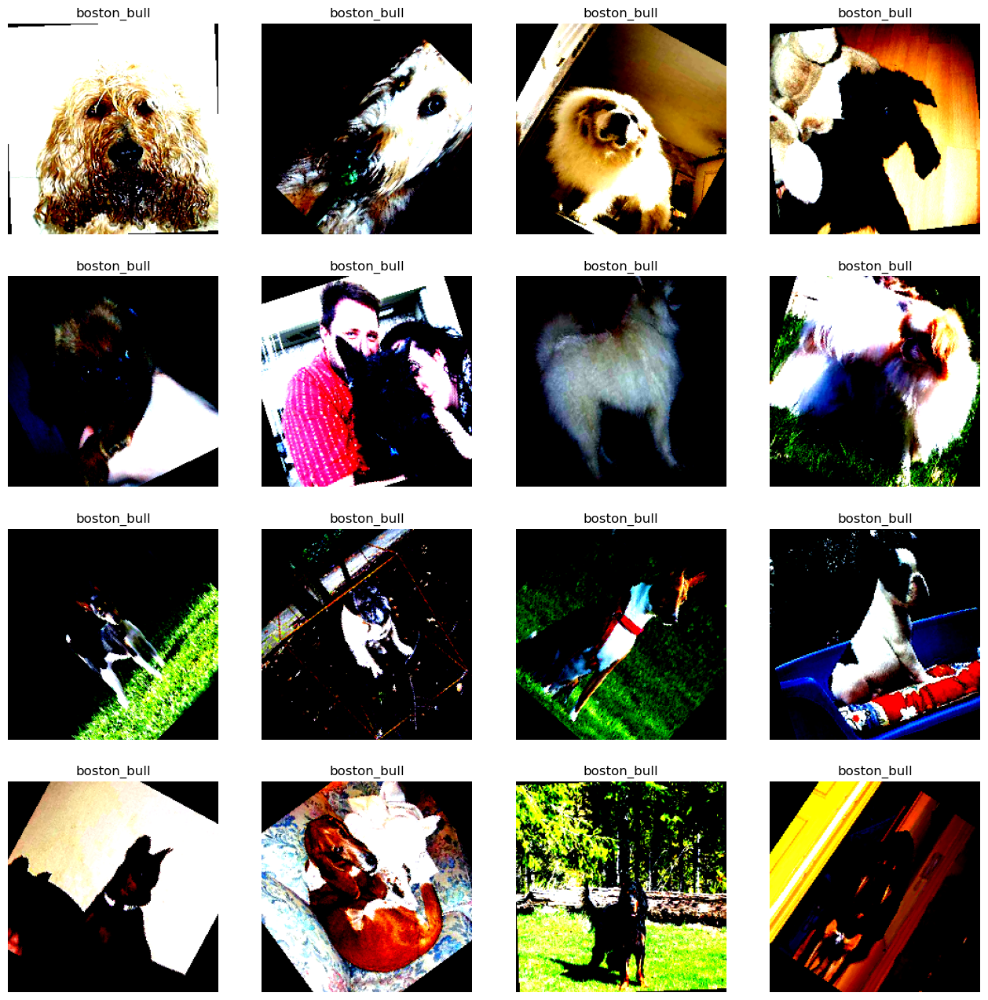

In [103]:
import torch
import matplotlib.pyplot as plt

# Iterate over a few batches from the DataLoader
for images, labels in train_loader:
    print(f"Batch shape - Images: {images.shape}, Labels: {labels.shape}")

    # Convert boolean labels to integers
    #int_labels = [np.argmax(label) for label in boolean_labels]

    # Print the images
    plt.figure(figsize=(16, 16))
    for i, image in enumerate(images[:16]):
        plt.subplot(4, 4, i + 1)
        plt.imshow(image.permute(1, 2, 0))  # Permute the dimensions for correct display
        plt.title(unique_breeds[boolean_labels[i]])  # Add label as title
        plt.axis("off")

    plt.show()
    break



In [104]:
example_image = torch.randn(3, 224, 224)  # Example image tensor
transposed_image = transpose_transform(example_image)

In [105]:
import torchvision
from torch import nn

#atonomyn of model


#model 2

Training Dataset:


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch shape - Images: torch.Size([32, 3, 224, 224]), Labels: torch.Size([32])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


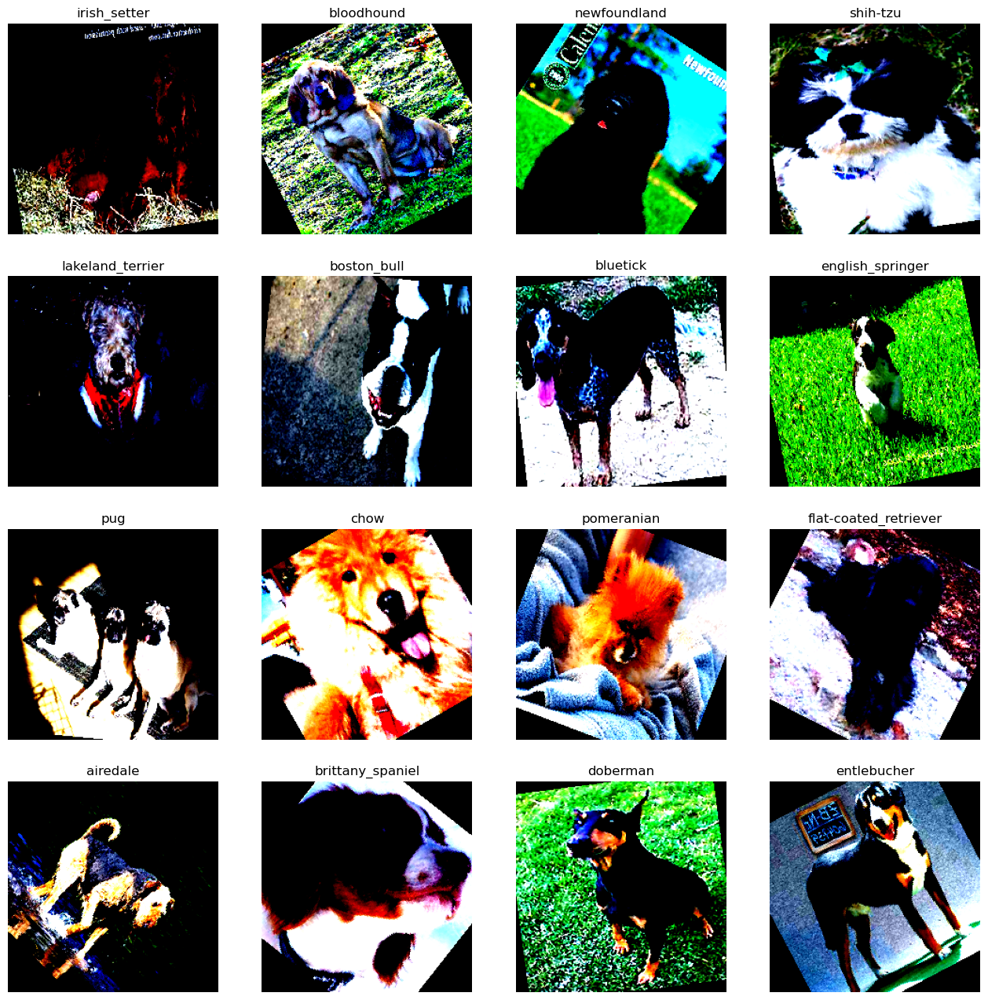

Test Dataset:


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Batch shape - Images: torch.Size([32, 3, 224, 224]), Labels: torch.Size([32])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


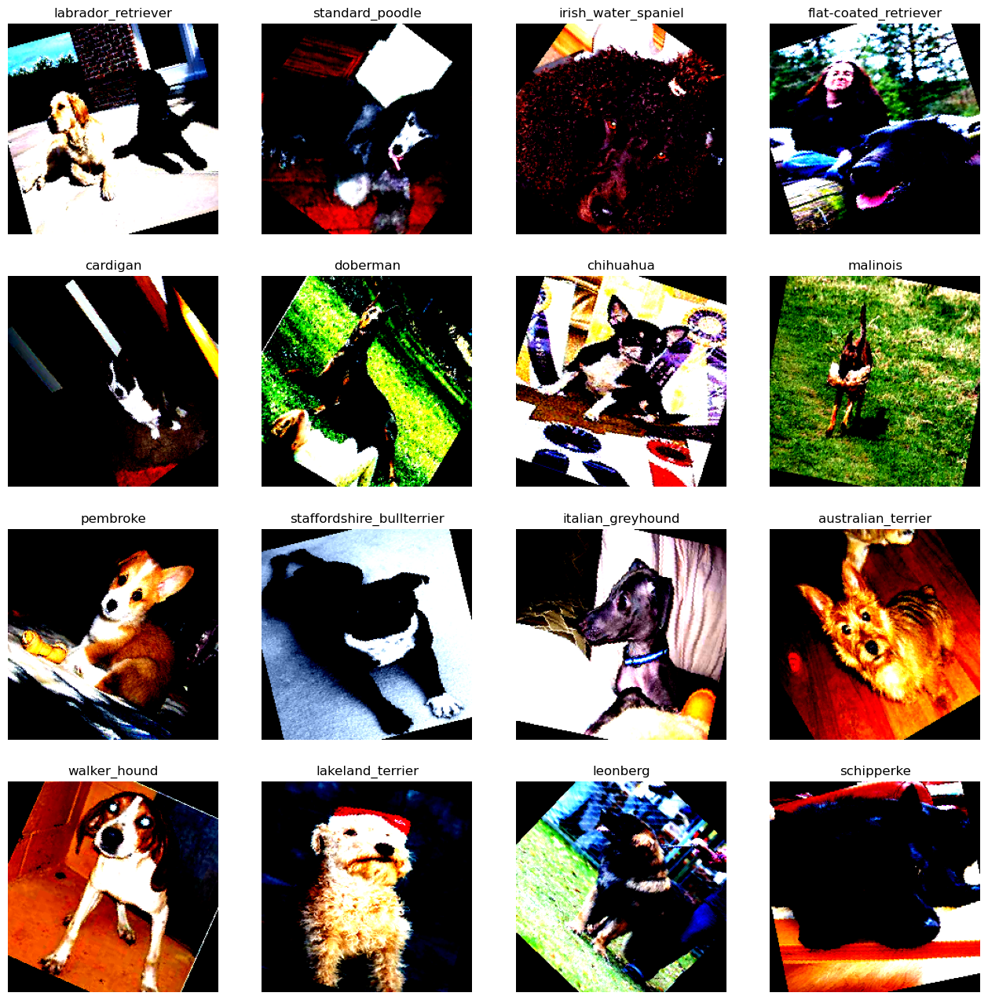

In [106]:
import torch
import matplotlib.pyplot as plt
torch.manual_seed(42)
def test_dataset(dataset_loader):
    for images, labels in dataset_loader:
        print(f"Batch shape - Images: {images.shape}, Labels: {labels.shape}")

        # Print the first few images with their labels
        plt.figure(figsize=(16, 16))
        for i in range(min(len(images), 16)):
            plt.subplot(4, 4, i + 1)
            plt.imshow(images[i].permute(1, 2, 0))  # Permute the dimensions for correct display
            plt.title(unique_breeds[labels[i]])  # Add label as title
            plt.axis("off")

        plt.show()
        break

# Test the training dataset
print("Training Dataset:")
test_dataset(train_loader)

# Test the test dataset
print("Test Dataset:")
test_dataset(test_loader)


In [107]:
import torch

def set_seeds(seed=42):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)  # if you use multi-GPU
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)

# Call the function to set the seeds
set_seeds()



In [108]:
import torchvision
from torch import nn

# Get num out features (one for each class pizza, steak, sushi)
OUT_FEATURES = len(unique_breeds)

# Create an EffNetB0 feature extractor
def create_effnetb0():
    # 1. Get the base mdoel with pretrained weights and send to target device
    weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT
    model = torchvision.models.efficientnet_b0(weights=weights).to(device)

    # 2. Freeze the base model layers
    for param in model.features.parameters():
        param.requires_grad = False

    # 3. Set the seeds
    set_seeds()

    # 4. Change the classifier head
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.2),
        nn.Linear(in_features=1280, out_features=OUT_FEATURES)
    ).to(device)

    # 5. Give the model a name
    model.name = "effnetb0"
    print(f"[INFO] Created new {model.name} model.")
    return model

# Create an EffNetB2 feature extractor
def create_effnetb2():
    # 1. Get the base model with pretrained weights and send to target device
    weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
    model = torchvision.models.efficientnet_b2(weights=weights).to(device)

    # 2. Freeze the base model layers
    for param in model.features.parameters():
        param.requires_grad = False

    # 3. Set the seeds
    set_seeds()

    # 4. Change the classifier head
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.3),
        nn.Linear(in_features=1408, out_features=OUT_FEATURES)
    ).to(device)

    # 5. Give the model a name
    model.name = "effnetb2"
    print(f"[INFO] Created new {model.name} model.")
    return model

def create_vit():
    # 1. Get pretrained weights for ViT-Base
  pretrained_vit_weights = torchvision.models.ViT_B_16_Weights.DEFAULT # requires torchvision >= 0.13, "DEFAULT" means best available

  # 2. Setup a ViT model instance with pretrained weights
  model = torchvision.models.vit_b_16(weights=pretrained_vit_weights).to(device)

  # 3. Freeze the base parameters
  for parameter in model.parameters():
      parameter.requires_grad = False

  # 4. Change the classifier head (set the seeds to ensure same initialization with linear head)
  set_seeds()
  model.heads = nn.Linear(in_features=768, out_features=len(unique_breeds)).to(device)
  # 5. Give the model a name
  model.name = "vision transformer"
  print(f"[INFO] Created new {model.name} model.")
  return model

def create_mobilenet_v2():
  pretrained_mobile_v2_weights= torchvision.models.MobileNet_V2_Weights.DEFAULT
  model= torchvision.models.mobilenet_v2(weights= pretrained_mobile_v2_weights).to(device)
   #freeze the base paramets

  for parameter in model.parameters():
      
      parameter.required_grad= False

  set_seeds()
  model.classifier=nn.Sequential(
      nn.Dropout(p=0.3),
      nn.Linear(in_features=1280, out_features=len(unique_breeds))
  ).to(device)

  model.name="mobilenet_v2"
  print(f"[INFO] Created new {model.name} model.")
  return model







In [68]:
eff_model=create_vit()

[INFO] Created new vision transformer model.


In [69]:
effnetb0=create_effnetb0()

[INFO] Created new effnetb0 model.


In [70]:
effnetb2=create_effnetb2()

[INFO] Created new effnetb2 model.


In [71]:
from torchinfo import summary

In [55]:
summary(effnetb2,
        input_size=(32, 3, 224, 224),
        verbose=0,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 120]            --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1408, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

In [56]:
summary(effnetb0,
        input_size=(32, 3, 224, 224),
        verbose=0,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 120]            --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

In [54]:
summary(eff_model,
        input_size=(32, 3, 224, 224),
        verbose=0,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

C:\Users\Inzayn\miniconda3\envs\cuda_pytorch\Lib\site-packages\torch\nn\modules\activation.py:1196: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:263.)
  return torch._native_multi_head_attention(


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
VisionTransformer (VisionTransformer)                        [32, 3, 224, 224]    [32, 120]            768                  Partial
├─Conv2d (conv_proj)                                         [32, 3, 224, 224]    [32, 768, 14, 14]    (590,592)            False
├─Encoder (encoder)                                          [32, 197, 768]       [32, 197, 768]       151,296              False
│    └─Dropout (dropout)                                     [32, 197, 768]       [32, 197, 768]       --                   --
│    └─Sequential (layers)                                   [32, 197, 768]       [32, 197, 768]       --                   False
│    │    └─EncoderBlock (encoder_layer_0)                   [32, 197, 768]       [32, 197, 768]       (7,087,872)          False
│    │    └─EncoderBlock (encoder_layer_1)                   [32, 197, 768]       [32, 

In [55]:
  #pretrained_mobile_v2_weights= torchvision.models.MobileNet_V2_Weights.DEFAULT
  model= create_mobilenet_v2()

[INFO] Created new mobilenet_v2 model.


In [56]:
from torchinfo import summary

In [57]:
summary(model,
        input_size=(32, 3, 224, 224),
        verbose=0,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
MobileNetV2 (MobileNetV2)                     [32, 3, 224, 224]    [32, 120]            --                   True
├─Sequential (features)                       [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   True
│    └─Conv2dNormActivation (0)               [32, 3, 224, 224]    [32, 32, 112, 112]   --                   True
│    │    └─Conv2d (0)                        [32, 3, 224, 224]    [32, 32, 112, 112]   864                  True
│    │    └─BatchNorm2d (1)                   [32, 32, 112, 112]   [32, 32, 112, 112]   64                   True
│    │    └─ReLU6 (2)                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─InvertedResidual (1)                   [32, 32, 112, 112]   [32, 16, 112, 112]   --                   True
│    │    └─Sequential (conv)                 [32, 32, 112, 112]   [32, 16, 112, 112]

In [110]:
import torchvision

In [111]:
from torch.utils.tensorboard import SummaryWriter




In [112]:
class EarlyStopping:
    def __init__(self, patience=3, delta=0, verbose=False):
        """
        Initialize EarlyStopping object.

        Args:
            patience (int): Number of epochs with no improvement after which training will be stopped.
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
            verbose (bool): If True, prints a message for each improvement.
        """
        self.patience = patience
        self.delta = delta
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf

    def __call__(self, val_loss, model):
        """
        Check if the model should stop training.

        Args:
            val_loss (float): Validation loss.
            model (torch.nn.Module): Model to be monitored.

        Returns:
            bool: True if training should stop, False otherwise.
        """
        score = -val_loss

        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.verbose:
                print(f"EarlyStopping counter: {self.counter} out of {self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

        return self.early_stop


In [113]:
import torch
from tqdm.auto import tqdm
def train_step(model: torch.nn.Module,
               dataloader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module,
               optimizer: torch.optim.Optimizer,
               device: torch.device):
    model.train()

    train_loss, train_acc = 0, 0

    for batch, (x, y) in enumerate(dataloader):
        x, y = x.to(device), y.to(device)
        # Forward pass
        y_pred = model(x)
        # Calculate loss
        loss = loss_fn(y_pred, y)
        train_loss += loss.item()
        # Optimizer zero grad
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Calculate accuracy
        y_pred_class = torch.argmax(torch.softmax(y_pred, dim=1), dim=1)
        train_acc += (y_pred_class == y).sum().item()

    # Adjust metrics to get average loss and accuracy per batch
    train_loss = train_loss / len(dataloader)
    train_acc = train_acc / len(dataloader.dataset)
    return train_loss, train_acc


def test_step(model: torch.nn.Module,
              dataloader: torch.utils.data.DataLoader,
              loss_fn: torch.nn.Module,
              device: torch.device):
  model.eval()

  test_loss, test_acc= 0,0

  with torch.inference_mode():
    #loop through dataloader and batches
    for batch, (x,y) in enumerate(dataloader):
      x,y= x.to(device), y.to(device)
      test_pred_logits= model(x)

      #calc loss
      loss= loss_fn(test_pred_logits, y)
      test_loss+= loss.item()
      #calc accuracy
      test_pred_labels= test_pred_logits.argmax(dim=1)
      test_acc+= ((test_pred_labels==y).sum().item()/len(test_pred_labels))


  test_loss= test_loss/len(dataloader)
  test_acc= test_acc/ len(dataloader)
  return test_loss, test_acc

def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device,
          writer: torch.utils.tensorboard.writer.SummaryWriter,
          early_stopping: EarlyStopping = None):

  results={"train_loss": [],
           "train_acc":[],
           "test_loss": [],
           "test_acc":[]
          }

  #loop through training and testing steps for a num of epochs
  for epoch in tqdm(range(epochs)):
    train_loss, train_acc=train_step(model=model,
                                     dataloader=train_dataloader,
                                     loss_fn=loss_fn,
                                     optimizer= optimizer,
                                     device= device)
    test_loss, test_acc= test_step(model=model,
                                   dataloader=test_dataloader,
                                   loss_fn=loss_fn,
                                   device=device)

    #print out whats happning
    print(
         f"Epoch: {epoch+1} | "
         f"train_loss: {train_loss:.4f} | "
         f"train_acc: {train_acc:.4f} | "
         f"test_loss: {test_loss:.4f} | "
         f"test_acc: {test_acc:.4f}"
     )
    #Update results dictionary
    results["train_loss"].append(train_loss)
    results["train_acc"].append(train_acc)
    results["test_loss"].append(test_loss)
    results["test_acc"].append(test_acc)

    ### New: Use the writer parameter to track experiments ###
        # See if there's a writer, if so, log to it
    if writer:
        # Add results to SummaryWriter
        writer.add_scalars(main_tag="Loss",
                           tag_scalar_dict={"train_loss": train_loss,
                                            "test_loss": test_loss},
                           global_step=epoch)
        writer.add_scalars(main_tag="Accuracy",
                           tag_scalar_dict={"train_acc": train_acc,
                                            "test_acc": test_acc},
                           global_step=epoch)
        # Close the writer
        writer.close()
    else:
        pass
    ### End new ###

    # Check if early stopping should be applied
    if early_stopping is not None:
        if early_stopping(test_loss, model):
            print("Early stopping triggered.")
            break

  return results









In [114]:
import torch
from pathlib import Path

def save_model(model: torch.nn.Module,
               target_dir: str,
               model_name: str):
  """Saves a PyTorch model to a target directory.

  Args:
    model: A target PyTorch model to save.
    target_dir: A directory for saving the model to.
    model_name: A filename for the saved model. Should include
      either ".pth" or ".pt" as the file extension.

  Example usage:
    save_model(model=model_0,
               target_dir="models",
               model_name="05_going_modular_tingvgg_model.pth")
  """
  # Create target directory
  target_dir_path = Path(target_dir)
  target_dir_path.mkdir(parents=True,
                        exist_ok=True)

  # Create model save path
  assert model_name.endswith(".pth") or model_name.endswith(".pt"), "model_name should end with '.pt' or '.pth'"
  model_save_path = target_dir_path / model_name

  # Save the model state_dict()
  print(f"[INFO] Saving model to: {model_save_path}")
  torch.save(obj=model.state_dict(),
             f=model_save_path)

In [115]:
from torch.utils.tensorboard import SummaryWriter

# Create a writer with all default settings
writer = SummaryWriter()

In [116]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [117]:
def create_writer(experiment_name: str,
                  model_name: str,
                  extra: str=None) -> torch.utils.tensorboard.writer.SummaryWriter():
    """Creates a torch.utils.tensorboard.writer.SummaryWriter() instance saving to a specific log_dir.

    log_dir is a combination of runs/timestamp/experiment_name/model_name/extra.

    Where timestamp is the current date in YYYY-MM-DD format.

    Args:
        experiment_name (str): Name of experiment.
        model_name (str): Name of model.
        extra (str, optional): Anything extra to add to the directory. Defaults to None.

    Returns:
        torch.utils.tensorboard.writer.SummaryWriter(): Instance of a writer saving to log_dir.

    Example usage:
        # Create a writer saving to "runs/2022-06-04/data_10_percent/effnetb2/5_epochs/"
        writer = create_writer(experiment_name="data_10_percent",
                               model_name="effnetb2",
                               extra="5_epochs")
        # The above is the same as:
        writer = SummaryWriter(log_dir="runs/2022-06-04/data_10_percent/effnetb2/5_epochs/")
    """
    from datetime import datetime
    import os

    # Get timestamp of current date (all experiments on certain day live in same folder)
    timestamp = datetime.now().strftime("%Y-%m-%d") # returns current date in YYYY-MM-DD format

    if extra:
        # Create log directory path
        log_dir = os.path.join("runs", timestamp, experiment_name, model_name, extra)
    else:
        log_dir = os.path.join("runs", timestamp, experiment_name, model_name)

    print(f"[INFO] Created SummaryWriter, saving to: {log_dir}...")
    return SummaryWriter(log_dir=log_dir)

In [79]:
# 1. Create epochs list
#num_epochs = [5, 10]
num_epochs= [7]
# 2. Create models list (need to create a new model for each experiment)
models = ["effnetb0", "effnetb2","mobilenet_v2"]

# 3. Create dataloaders dictionary for various dataloaders
# train_dataloaders = {"data_10_percent": train_dataloader_10_percent,
#                      "data_20_percent": train_dataloader_20_percent}

In [118]:
# 1. Create epochs list
num_epochs = [5, 10]

# 2. Create models list (need to create a new model for each experiment)
models = ["vision transformer rotary"]

In [119]:
%%time

# 1. Set the random seeds
set_seeds(seed=42)
# 2. Keep track of experiment numbers
experiment_number = 0

# 3. Loop through each DataLoader


    # 4. Loop through each number of epochs
for epochs in num_epochs:
    # 5. Loop through each model name and create a new model based on the name
    for model_name in models:
        from timeit import default_timer as timer
        start_time = timer()
        # 6. Create information print outs
        experiment_number += 1
        print(f"[INFO] Experiment number: {experiment_number}")
        print(f"[INFO] Model: {model_name}")

        print(f"[INFO] Number of epochs: {epochs}")
        # 7. Select the model
        if model_name == "effnetb0":
            model = create_effnetb0() # creates a new model each time (important because we want each experiment to start from scratch)
        elif model_name=="effnetb2":
            model = create_effnetb2() # creates a new model each time (important because we want each experiment to start from scratch)
        elif model_name=="vision transformer rotary":
            model= create_vit()
        else:
            model= create_mobilenet_v2()

        # 8. Create a new loss and optimizer for every model
        loss_fn = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(params=model.parameters(), lr=0.001)
        # 9. Train target model with target dataloaders and track experiments
        train(model=model,
              train_dataloader=train_loader,
              test_dataloader=test_loader,
              optimizer=optimizer,
              loss_fn=loss_fn,
              epochs=epochs,
              device=device,
              writer=create_writer(experiment_name="dog_vision",
                                   model_name=model_name,
                                   extra=f"{epochs}_epochs"))

        # 10. Save the model to file so we can get back the best model
        save_filepath = f"07_{model_name}_dog_vision_{epochs}_epochs.pth"
        save_model(model=model,
                   target_dir="models",
                   model_name=save_filepath)
        end_time=timer()
        print(f"total time taken by the experiment: {end_time-start_time}")
        print("-"*50 + "\n")

[INFO] Experiment number: 1
[INFO] Model: vision transformer rotary
[INFO] Number of epochs: 5
[INFO] Created new vision transformer model.
[INFO] Created SummaryWriter, saving to: runs\2024-05-12\dog_vision\vision transformer rotary\5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

C:\Users\Inzayn\miniconda3\envs\cuda_pytorch\Lib\site-packages\torch\nn\functional.py:5476: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:263.)
  attn_output = scaled_dot_product_attention(q, k, v, attn_mask, dropout_p, is_causal)


Epoch: 1 | train_loss: 1.7287 | train_acc: 0.7478 | test_loss: 0.5221 | test_acc: 0.8789
Epoch: 2 | train_loss: 0.3556 | train_acc: 0.9140 | test_loss: 0.4007 | test_acc: 0.8867
Epoch: 3 | train_loss: 0.2726 | train_acc: 0.9243 | test_loss: 0.3903 | test_acc: 0.8877
Epoch: 4 | train_loss: 0.2234 | train_acc: 0.9390 | test_loss: 0.4336 | test_acc: 0.8789
Epoch: 5 | train_loss: 0.1776 | train_acc: 0.9515 | test_loss: 0.3982 | test_acc: 0.8926
[INFO] Saving model to: models\07_vision transformer rotary_dog_vision_5_epochs.pth
total time taken by the experiment: 1327.9065749000292
--------------------------------------------------

[INFO] Experiment number: 2
[INFO] Model: vision transformer rotary
[INFO] Number of epochs: 10
[INFO] Created new vision transformer model.
[INFO] Created SummaryWriter, saving to: runs\2024-05-12\dog_vision\vision transformer rotary\10_epochs...


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.7287 | train_acc: 0.7478 | test_loss: 0.5221 | test_acc: 0.8789
Epoch: 2 | train_loss: 0.3556 | train_acc: 0.9140 | test_loss: 0.4007 | test_acc: 0.8867
Epoch: 3 | train_loss: 0.2726 | train_acc: 0.9243 | test_loss: 0.3903 | test_acc: 0.8877
Epoch: 4 | train_loss: 0.2234 | train_acc: 0.9390 | test_loss: 0.4336 | test_acc: 0.8789
Epoch: 5 | train_loss: 0.1776 | train_acc: 0.9515 | test_loss: 0.3982 | test_acc: 0.8926
Epoch: 6 | train_loss: 0.1579 | train_acc: 0.9563 | test_loss: 0.3919 | test_acc: 0.8848
Epoch: 7 | train_loss: 0.1368 | train_acc: 0.9625 | test_loss: 0.3877 | test_acc: 0.8809
Epoch: 8 | train_loss: 0.1130 | train_acc: 0.9683 | test_loss: 0.3684 | test_acc: 0.8916
Epoch: 9 | train_loss: 0.0986 | train_acc: 0.9735 | test_loss: 0.3719 | test_acc: 0.8926
Epoch: 10 | train_loss: 0.0873 | train_acc: 0.9768 | test_loss: 0.3507 | test_acc: 0.9053
[INFO] Saving model to: models\07_vision transformer rotary_dog_vision_10_epochs.pth
total time taken by the 

In [120]:
# Viewing TensorBoard in Jupyter and Google Colab Notebooks (uncomment to view full TensorBoard instance)
%load_ext tensorboard
%tensorboard --logdir runs --port 6007

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 18660), started 7:46:33 ago. (Use '!kill 18660' to kill it.)

#Making main model

In [202]:
# %%time

# # 1. Set the random seeds
# set_seeds(seed=42)
# # 2. Keep track of experiment numbers
# experiment_number = 0

# # 3. Loop through each DataLoader


#     # 4. Loop through each number of epochs
# for epochs in num_epochs:
#     # 5. Loop through each model name and create a new model based on the name
#     for model_name in models:
#         from timeit import default_timer as timer
#         start_time = timer()
#         # 6. Create information print outs
#         experiment_number += 1
#         print(f"[INFO] Experiment number: {experiment_number}")
#         print(f"[INFO] Model: {model_name}")

#         print(f"[INFO] Number of epochs: {epochs}")
#         # 7. Select the model
#         if model_name == "effnetb0":
#             model = create_effnetb0() # creates a new model each time (important because we want each experiment to start from scratch)
#         elif model_name=="effnetb2":
#             model = create_effnetb2() # creates a new model each time (important because we want each experiment to start from scratch)
#         elif model_name=="vision transformer":
#             model= create_vit()
#         else:
#             model= create_mobilenet_v2()

#         # 8. Create a new loss and optimizer for every model
#         loss_fn = nn.CrossEntropyLoss()
#         optimizer = torch.optim.Adam(params=model.parameters(), lr=0.001)
#         # 9. Train target model with target dataloaders and track experiments
#         train(model=model,
#               train_dataloader=train_loader,
#               test_dataloader=test_loader,
#               optimizer=optimizer,
#               loss_fn=loss_fn,
#               epochs=epochs,
#               device=device,
#               writer=create_writer(experiment_name="dog_vision",
#                                    model_name=model_name,
#                                    extra=f"{epochs}_epochs"))

#         # 10. Save the model to file so we can get back the best model
#         save_filepath = f"07_{model_name}_dog_vision_{epochs}_epochs.pth"
#         save_model(model=model,
#                    target_dir="models",
#                    model_name=save_filepath)
#         end_time=timer()
#         print(f"total time taken by the experiment: {end_time-start_time}")
#         print("-"*50 + "\n")

In [121]:
device

device(type='cuda')

In [121]:
def create_vit():
    # 1. Get pretrained weights for ViT-Base
  pretrained_vit_weights = torchvision.models.ViT_B_16_Weights.DEFAULT # requires torchvision >= 0.13, "DEFAULT" means best available

  # 2. Setup a ViT model instance with pretrained weights
  model = torchvision.models.vit_b_16(weights=pretrained_vit_weights).to(device)

  # 3. Freeze the base parameters
  for parameter in model.parameters():
      parameter.requires_grad = False

  # 4. Change the classifier head (set the seeds to ensure same initialization with linear head)
  set_seeds()
  model.heads = nn.Linear(in_features=768, out_features=len(unique_breeds)).to(device)
  # 5. Give the model a name
  model.name = "vision transformer"
  print(f"[INFO] Created new {model.name} model.")
  return model

In [122]:
epochs= 5
early_stopping = EarlyStopping(patience=3, verbose=True)
model_name="Vision_Transformer"
model_big = create_vit().to(device)

[INFO] Created new vision transformer model.


In [123]:
summary(model_big,
        input_size=(32, 3, 224, 224),
        verbose=0,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

C:\Users\Inzayn\miniconda3\envs\cuda_pytorch\Lib\site-packages\torch\nn\modules\activation.py:1196: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:263.)
  return torch._native_multi_head_attention(


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
VisionTransformer (VisionTransformer)                        [32, 3, 224, 224]    [32, 120]            768                  Partial
├─Conv2d (conv_proj)                                         [32, 3, 224, 224]    [32, 768, 14, 14]    (590,592)            False
├─Encoder (encoder)                                          [32, 197, 768]       [32, 197, 768]       151,296              False
│    └─Dropout (dropout)                                     [32, 197, 768]       [32, 197, 768]       --                   --
│    └─Sequential (layers)                                   [32, 197, 768]       [32, 197, 768]       --                   False
│    │    └─EncoderBlock (encoder_layer_0)                   [32, 197, 768]       [32, 197, 768]       (7,087,872)          False
│    │    └─EncoderBlock (encoder_layer_1)                   [32, 197, 768]       [32, 

In [99]:
%%time

# 1. Set the random seeds
set_seeds(seed=42)
# 2. Keep track of experiment numbers
experiment_number = 0

# 3. Loop through each DataLoader



    # 5. Loop through each model name and create a new model based on the name

from timeit import default_timer as timer
start_time = timer()

print(f"[INFO] Number of epochs: {epochs}")
# 7. Select the model
model_name="Vision_Transformer"
model_big = create_vit().to(device) # creates a new model each time (important because we want each experiment to start from scratch)

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params=model_big.parameters(), lr=0.001)
# 9. Train target model with target dataloaders and track experiments
train(model=model_big,
      train_dataloader=train_loader,
      test_dataloader=test_loader,
      optimizer=optimizer,
      loss_fn=loss_fn,
      epochs=epochs,
      device=device,
      writer=create_writer(experiment_name="dog_vision",
                           model_name=model_name,
                           extra=f"{epochs}_epochs")
     )
# 10. Save the model to file so we can get back the best model
save_filepath = f"07_{model_name}_FULL_dog_vision_main_{epochs}_epochs.pth"
save_model(model=model_big,
           target_dir="models",
           model_name=save_filepath)
end_time=timer()
print(f"total time taken by the experiment: {end_time-start_time}")
print("-"*50 + "\n")

[INFO] Number of epochs: 5
[INFO] Created new vision transformer model.
[INFO] Created SummaryWriter, saving to: runs\2024-04-24\dog_vision\Vision_Transformer\5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.1636 | train_acc: 0.7847 | test_loss: 0.4286 | test_acc: 0.8720
Epoch: 2 | train_loss: 0.2904 | train_acc: 0.9170 | test_loss: 0.4063 | test_acc: 0.8840
Epoch: 3 | train_loss: 0.2211 | train_acc: 0.9317 | test_loss: 0.3737 | test_acc: 0.8980
Epoch: 4 | train_loss: 0.1625 | train_acc: 0.9485 | test_loss: 0.3826 | test_acc: 0.8870
Epoch: 5 | train_loss: 0.1280 | train_acc: 0.9597 | test_loss: 0.4364 | test_acc: 0.8730
[INFO] Saving model to: models\07_Vision_Transformer_FULL_dog_vision_main_5_epochs.pth
total time taken by the experiment: 2605.242865400156
--------------------------------------------------

CPU times: total: 57min 4s
Wall time: 43min 25s


In [2]:
# Viewing TensorBoard in Jupyter and Google Colab Notebooks (uncomment to view full TensorBoard instance)
%reload_ext tensorboard
%tensorboard --logdir runs --port 6006

In [139]:
tensorboard --logdir=d:/data --host 0.0.0.0


Reusing TensorBoard on port 6006 (pid 16776), started 0:00:40 ago. (Use '!kill 16776' to kill it.)

In [140]:
%reload_ext tensorboard
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 10772), started 18 days, 4:56:56 ago. (Use '!kill 10772' to kill it.)

In [81]:
def load_model(model_path, num_classes):
    # Load the model architecture
    model = torchvision.models.vit_b_16(pretrained=False)

    # Load the state dictionary
    state_dict = torch.load(model_path)

    # Modify the state dictionary keys to match the current model architecture
    new_state_dict = {}
    for key, value in state_dict.items():
        if key.startswith('heads.'):
            # Replace 'heads' with 'head' to match the modified model's architecture
            key = key.replace('heads', 'head')
            # Resize the classifier head weights if the number of classes has changed
            if 'weight' in key:
                value = value[:num_classes, :] if value.shape[0] > num_classes else value
            new_state_dict[key] = value

    # Load the modified state dictionary
    model.load_state_dict(new_state_dict)

    return model




In [82]:
model= load_model("models/07_Vision_Transformer_FULL_dog_vision_main_10_epochs.pth", 120)

C:\Users\Inzayn\miniconda3\envs\cuda_pytorch\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Inzayn\miniconda3\envs\cuda_pytorch\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


RuntimeError: Error(s) in loading state_dict for VisionTransformer:
	Missing key(s) in state_dict: "class_token", "conv_proj.weight", "conv_proj.bias", "encoder.pos_embedding", "encoder.layers.encoder_layer_0.ln_1.weight", "encoder.layers.encoder_layer_0.ln_1.bias", "encoder.layers.encoder_layer_0.self_attention.in_proj_weight", "encoder.layers.encoder_layer_0.self_attention.in_proj_bias", "encoder.layers.encoder_layer_0.self_attention.out_proj.weight", "encoder.layers.encoder_layer_0.self_attention.out_proj.bias", "encoder.layers.encoder_layer_0.ln_2.weight", "encoder.layers.encoder_layer_0.ln_2.bias", "encoder.layers.encoder_layer_0.mlp.0.weight", "encoder.layers.encoder_layer_0.mlp.0.bias", "encoder.layers.encoder_layer_0.mlp.3.weight", "encoder.layers.encoder_layer_0.mlp.3.bias", "encoder.layers.encoder_layer_1.ln_1.weight", "encoder.layers.encoder_layer_1.ln_1.bias", "encoder.layers.encoder_layer_1.self_attention.in_proj_weight", "encoder.layers.encoder_layer_1.self_attention.in_proj_bias", "encoder.layers.encoder_layer_1.self_attention.out_proj.weight", "encoder.layers.encoder_layer_1.self_attention.out_proj.bias", "encoder.layers.encoder_layer_1.ln_2.weight", "encoder.layers.encoder_layer_1.ln_2.bias", "encoder.layers.encoder_layer_1.mlp.0.weight", "encoder.layers.encoder_layer_1.mlp.0.bias", "encoder.layers.encoder_layer_1.mlp.3.weight", "encoder.layers.encoder_layer_1.mlp.3.bias", "encoder.layers.encoder_layer_2.ln_1.weight", "encoder.layers.encoder_layer_2.ln_1.bias", "encoder.layers.encoder_layer_2.self_attention.in_proj_weight", "encoder.layers.encoder_layer_2.self_attention.in_proj_bias", "encoder.layers.encoder_layer_2.self_attention.out_proj.weight", "encoder.layers.encoder_layer_2.self_attention.out_proj.bias", "encoder.layers.encoder_layer_2.ln_2.weight", "encoder.layers.encoder_layer_2.ln_2.bias", "encoder.layers.encoder_layer_2.mlp.0.weight", "encoder.layers.encoder_layer_2.mlp.0.bias", "encoder.layers.encoder_layer_2.mlp.3.weight", "encoder.layers.encoder_layer_2.mlp.3.bias", "encoder.layers.encoder_layer_3.ln_1.weight", "encoder.layers.encoder_layer_3.ln_1.bias", "encoder.layers.encoder_layer_3.self_attention.in_proj_weight", "encoder.layers.encoder_layer_3.self_attention.in_proj_bias", "encoder.layers.encoder_layer_3.self_attention.out_proj.weight", "encoder.layers.encoder_layer_3.self_attention.out_proj.bias", "encoder.layers.encoder_layer_3.ln_2.weight", "encoder.layers.encoder_layer_3.ln_2.bias", "encoder.layers.encoder_layer_3.mlp.0.weight", "encoder.layers.encoder_layer_3.mlp.0.bias", "encoder.layers.encoder_layer_3.mlp.3.weight", "encoder.layers.encoder_layer_3.mlp.3.bias", "encoder.layers.encoder_layer_4.ln_1.weight", "encoder.layers.encoder_layer_4.ln_1.bias", "encoder.layers.encoder_layer_4.self_attention.in_proj_weight", "encoder.layers.encoder_layer_4.self_attention.in_proj_bias", "encoder.layers.encoder_layer_4.self_attention.out_proj.weight", "encoder.layers.encoder_layer_4.self_attention.out_proj.bias", "encoder.layers.encoder_layer_4.ln_2.weight", "encoder.layers.encoder_layer_4.ln_2.bias", "encoder.layers.encoder_layer_4.mlp.0.weight", "encoder.layers.encoder_layer_4.mlp.0.bias", "encoder.layers.encoder_layer_4.mlp.3.weight", "encoder.layers.encoder_layer_4.mlp.3.bias", "encoder.layers.encoder_layer_5.ln_1.weight", "encoder.layers.encoder_layer_5.ln_1.bias", "encoder.layers.encoder_layer_5.self_attention.in_proj_weight", "encoder.layers.encoder_layer_5.self_attention.in_proj_bias", "encoder.layers.encoder_layer_5.self_attention.out_proj.weight", "encoder.layers.encoder_layer_5.self_attention.out_proj.bias", "encoder.layers.encoder_layer_5.ln_2.weight", "encoder.layers.encoder_layer_5.ln_2.bias", "encoder.layers.encoder_layer_5.mlp.0.weight", "encoder.layers.encoder_layer_5.mlp.0.bias", "encoder.layers.encoder_layer_5.mlp.3.weight", "encoder.layers.encoder_layer_5.mlp.3.bias", "encoder.layers.encoder_layer_6.ln_1.weight", "encoder.layers.encoder_layer_6.ln_1.bias", "encoder.layers.encoder_layer_6.self_attention.in_proj_weight", "encoder.layers.encoder_layer_6.self_attention.in_proj_bias", "encoder.layers.encoder_layer_6.self_attention.out_proj.weight", "encoder.layers.encoder_layer_6.self_attention.out_proj.bias", "encoder.layers.encoder_layer_6.ln_2.weight", "encoder.layers.encoder_layer_6.ln_2.bias", "encoder.layers.encoder_layer_6.mlp.0.weight", "encoder.layers.encoder_layer_6.mlp.0.bias", "encoder.layers.encoder_layer_6.mlp.3.weight", "encoder.layers.encoder_layer_6.mlp.3.bias", "encoder.layers.encoder_layer_7.ln_1.weight", "encoder.layers.encoder_layer_7.ln_1.bias", "encoder.layers.encoder_layer_7.self_attention.in_proj_weight", "encoder.layers.encoder_layer_7.self_attention.in_proj_bias", "encoder.layers.encoder_layer_7.self_attention.out_proj.weight", "encoder.layers.encoder_layer_7.self_attention.out_proj.bias", "encoder.layers.encoder_layer_7.ln_2.weight", "encoder.layers.encoder_layer_7.ln_2.bias", "encoder.layers.encoder_layer_7.mlp.0.weight", "encoder.layers.encoder_layer_7.mlp.0.bias", "encoder.layers.encoder_layer_7.mlp.3.weight", "encoder.layers.encoder_layer_7.mlp.3.bias", "encoder.layers.encoder_layer_8.ln_1.weight", "encoder.layers.encoder_layer_8.ln_1.bias", "encoder.layers.encoder_layer_8.self_attention.in_proj_weight", "encoder.layers.encoder_layer_8.self_attention.in_proj_bias", "encoder.layers.encoder_layer_8.self_attention.out_proj.weight", "encoder.layers.encoder_layer_8.self_attention.out_proj.bias", "encoder.layers.encoder_layer_8.ln_2.weight", "encoder.layers.encoder_layer_8.ln_2.bias", "encoder.layers.encoder_layer_8.mlp.0.weight", "encoder.layers.encoder_layer_8.mlp.0.bias", "encoder.layers.encoder_layer_8.mlp.3.weight", "encoder.layers.encoder_layer_8.mlp.3.bias", "encoder.layers.encoder_layer_9.ln_1.weight", "encoder.layers.encoder_layer_9.ln_1.bias", "encoder.layers.encoder_layer_9.self_attention.in_proj_weight", "encoder.layers.encoder_layer_9.self_attention.in_proj_bias", "encoder.layers.encoder_layer_9.self_attention.out_proj.weight", "encoder.layers.encoder_layer_9.self_attention.out_proj.bias", "encoder.layers.encoder_layer_9.ln_2.weight", "encoder.layers.encoder_layer_9.ln_2.bias", "encoder.layers.encoder_layer_9.mlp.0.weight", "encoder.layers.encoder_layer_9.mlp.0.bias", "encoder.layers.encoder_layer_9.mlp.3.weight", "encoder.layers.encoder_layer_9.mlp.3.bias", "encoder.layers.encoder_layer_10.ln_1.weight", "encoder.layers.encoder_layer_10.ln_1.bias", "encoder.layers.encoder_layer_10.self_attention.in_proj_weight", "encoder.layers.encoder_layer_10.self_attention.in_proj_bias", "encoder.layers.encoder_layer_10.self_attention.out_proj.weight", "encoder.layers.encoder_layer_10.self_attention.out_proj.bias", "encoder.layers.encoder_layer_10.ln_2.weight", "encoder.layers.encoder_layer_10.ln_2.bias", "encoder.layers.encoder_layer_10.mlp.0.weight", "encoder.layers.encoder_layer_10.mlp.0.bias", "encoder.layers.encoder_layer_10.mlp.3.weight", "encoder.layers.encoder_layer_10.mlp.3.bias", "encoder.layers.encoder_layer_11.ln_1.weight", "encoder.layers.encoder_layer_11.ln_1.bias", "encoder.layers.encoder_layer_11.self_attention.in_proj_weight", "encoder.layers.encoder_layer_11.self_attention.in_proj_bias", "encoder.layers.encoder_layer_11.self_attention.out_proj.weight", "encoder.layers.encoder_layer_11.self_attention.out_proj.bias", "encoder.layers.encoder_layer_11.ln_2.weight", "encoder.layers.encoder_layer_11.ln_2.bias", "encoder.layers.encoder_layer_11.mlp.0.weight", "encoder.layers.encoder_layer_11.mlp.0.bias", "encoder.layers.encoder_layer_11.mlp.3.weight", "encoder.layers.encoder_layer_11.mlp.3.bias", "encoder.ln.weight", "encoder.ln.bias", "heads.head.weight", "heads.head.bias". 
	Unexpected key(s) in state_dict: "head.weight", "head.bias". 

In [ ]:
def load_vit(model_path):
    # 1. Get pretrained weights for ViT-Base
  model = torchvision.models.vit_b_16(pretrained=False).to(device)
  model.heads = nn.Linear(in_features=768, out_features=len(unique_breeds)).to(device)
  model.load_state_dict(torch.load(model_path)) # requires torchvision >= 0.13, "DEFAULT" means best available



  model.eval()

  # 4. Change the classifier head (set the seeds to ensure same initialization with linear head)
  set_seeds()

  # 5. Give the model a name
  model.name = "vision transformer"
  print(f"[INFO] Created new {model.name} model.")
  return model

In [ ]:
loaded_model=load_vit("models/07_Vision_Transformer_FULL_dog_vision_main_10_epochs.pth")

In [ ]:
summary(loaded_model,
        input_size=(32, 3, 224, 224),
        verbose=0,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

In [83]:
import pathlib
import torch

from PIL import Image
from timeit import default_timer as timer
from tqdm.auto import tqdm
from typing import List, Dict

# 1. Create a function to return a list of dictionaries with sample, truth label, prediction, prediction probability and prediction time
def pred_and_store(paths: List[str],
                   model: torch.nn.Module,
                   transform: torchvision.transforms,
                   class_names: List[str],
                   device: str = "cuda" if torch.cuda.is_available() else "cpu") -> List[Dict]:

    # 2. Create an empty list to store prediction dictionaires
    pred_list = []

    # 3. Loop through target paths
    for path in tqdm(paths):

        # 4. Create empty dictionary to store prediction information for each sample
        pred_dict = {}

        # 5. Get the sample path and ground truth class name
        pred_dict["image_path"] = path
        class_name = path.parent.stem
        pred_dict["class_name"] = class_name

        # 6. Start the prediction timer
        start_time = timer()

        # 7. Open image path
        img = Image.open(path)

        # 8. Transform the image, add batch dimension and put image on target device
        transformed_image = transform(img).unsqueeze(0).to(device)

        # 9. Prepare model for inference by sending it to target device and turning on eval() mode
        model.to(device)
        model.eval()

        # 10. Get prediction probability, predicition label and prediction class
        with torch.inference_mode():
            pred_logit = model(transformed_image) # perform inference on target sample
            pred_prob = torch.softmax(pred_logit, dim=1) # turn logits into prediction probabilities
            pred_label = torch.argmax(pred_prob, dim=1) # turn prediction probabilities into prediction label
            pred_class = class_names[pred_label.cpu()] # hardcode prediction class to be on CPU

            # 11. Make sure things in the dictionary are on CPU (required for inspecting predictions later on)
            pred_dict["pred_prob"] = round(pred_prob.unsqueeze(0).max().cpu().item(), 4)
            pred_dict["pred_class"] = pred_class

            # 12. End the timer and calculate time per pred
            end_time = timer()
            pred_dict["time_for_pred"] = round(end_time-start_time, 4)

        # 13. Does the pred match the true label?
        pred_dict["correct"] = class_name == pred_class

        # 14. Add the dictionary to the list of preds
        pred_list.append(pred_dict)

    # 15. Return list of prediction dictionaries
    return pred_list

In [84]:
test_filepath= ["drive/MyDrive/Dog vision/test/"+fname+".jpg" for fname in labels["id"]]


IndexError: too many indices for tensor of dimension 1

In [85]:
# Make list of prediction dictionaries with ViT feature extractor model on test images
vit_test_pred_dicts = pred_and_store(paths=test_filepath,
                                     model=loaded_model,
                                     transform=transpose_transform,
                                     class_names=unique_breeds,
                                     device="cpu")

NameError: name 'test_filepath' is not defined

# running the non pretrained model with code

##  creating a input patch imbedding layer into a pytorch module

In [125]:
# 1. Create a class which subclasses nn.Module
class PatchEmbedding(nn.Module):
    """Turns a 2D input image into a 1D sequence learnable embedding vector.

    Args:
        in_channels (int): Number of color channels for the input images. Defaults to 3.
        patch_size (int): Size of patches to convert input image into. Defaults to 16.
        embedding_dim (int): Size of embedding to turn image into. Defaults to 768.
    """
    # 2. Initialize the class with appropriate variables
    def __init__(self,
                 in_channels:int=3,
                 patch_size:int=16,
                 embedding_dim:int=768):
        super().__init__()

        # 3. Create a layer to turn an image into patches
        self.patcher = nn.Conv2d(in_channels=in_channels,
                                 out_channels=embedding_dim,
                                 kernel_size=patch_size,
                                 stride=patch_size,
                                 padding=0)

        # 4. Create a layer to flatten the patch feature maps into a single dimension
        self.flatten = nn.Flatten(start_dim=2, # only flatten the feature map dimensions into a single vector
                                  end_dim=3)

    # 5. Define the forward method
    def forward(self, x):
        # Create assertion to check that inputs are the correct shape
        image_resolution = x.shape[-1]
        assert image_resolution % patch_size == 0, f"Input image size must be divisble by patch size, image shape: {image_resolution}, patch size: {patch_size}"

        # Perform the forward pass
        x_patched = self.patcher(x)
        x_flattened = self.flatten(x_patched)
        # 6. Make sure the output shape has the right order
        return x_flattened.permute(0, 2, 1) # adjust so the embedding is on the final dimension [batch_size, P^2•C, N] -> [batch_size, N, P^2•C]

# creating a final Image processing unit 

In [126]:
set_seeds()

# 1. Set patch size
patch_size = 16

# 2. Print shape of original image tensor and get the image dimensions
print(f"Image tensor shape: {image.shape}")
height, width = image.shape[1], image.shape[2]

# 3. Get image tensor and add batch dimension
x = image.unsqueeze(0)
print(f"Input image with batch dimension shape: {x.shape}")

# 4. Create patch embedding layer
patch_embedding_layer = PatchEmbedding(in_channels=3,
                                       patch_size=patch_size,
                                       embedding_dim=768)

# 5. Pass image through patch embedding layer
patch_embedding = patch_embedding_layer(x)
print(f"Patching embedding shape: {patch_embedding.shape}")

# 6. Create class token embedding
batch_size = patch_embedding.shape[0]
embedding_dimension = patch_embedding.shape[-1]
class_token = nn.Parameter(torch.ones(batch_size, 1, embedding_dimension),
                           requires_grad=True) # make sure it's learnable
print(f"Class token embedding shape: {class_token.shape}")

# 7. Prepend class token embedding to patch embedding
patch_embedding_class_token = torch.cat((class_token, patch_embedding), dim=1)
print(f"Patch embedding with class token shape: {patch_embedding_class_token.shape}")

# 8. Create position embedding
number_of_patches = int((height * width) / patch_size**2)
position_embedding = nn.Parameter(torch.ones(1, number_of_patches+1, embedding_dimension),
                                  requires_grad=True) # make sure it's learnable

# 9. Add position embedding to patch embedding with class token
patch_and_position_embedding = patch_embedding_class_token + position_embedding
print(f"Patch and position embedding shape: {patch_and_position_embedding.shape}")

AttributeError: 'list' object has no attribute 'shape'

#sekf attention of rotary position embedding

In [127]:
import torch
import torch.nn as nn
import math
from functools import partial

def init_2d_freqs(dim: int, num_heads: int, theta: float = 10.0, rotate: bool = True):
    freqs_x = []
    freqs_y = []
    mag = 1 / (theta ** (torch.arange(0, dim, 4)[: (dim // 4)].float() / dim))
    for i in range(num_heads):
        angles = torch.rand(1) * 2 * torch.pi if rotate else torch.zeros(1)        
        fx = torch.cat([mag * torch.cos(angles), mag * torch.cos(torch.pi/2 + angles)], dim=-1)
        fy = torch.cat([mag * torch.sin(angles), mag * torch.sin(torch.pi/2 + angles)], dim=-1)
        freqs_x.append(fx)
        freqs_y.append(fy)
    freqs_x = torch.stack(freqs_x, dim=0)
    freqs_y = torch.stack(freqs_y, dim=0)
    freqs = torch.stack([freqs_x, freqs_y], dim=0)
    return freqs

def init_t_xy(end_x: int, end_y: int):
    t = torch.arange(end_x * end_y, dtype=torch.float32)
    t_x = (t % end_x).float()
    t_y = torch.div(t, end_x, rounding_mode='floor').float()
    return t_x, t_y

def compute_mixed_cis(freqs: torch.Tensor, t_x: torch.Tensor, t_y: torch.Tensor, num_heads: int):
    N = t_x.shape[0]
    # No float 16 for this range
    with torch.cuda.amp.autocast(enabled=False):
        freqs_x = (t_x.unsqueeze(-1) @ freqs[0].unsqueeze(-2)).view(N, num_heads, -1).permute(1, 0, 2)
        freqs_y = (t_y.unsqueeze(-1) @ freqs[1].unsqueeze(-2)).view(N, num_heads, -1).permute(1, 0, 2)
        freqs_cis = torch.polar(torch.ones_like(freqs_x), freqs_x + freqs_y)
    return freqs_cis

def compute_axial_cis(dim: int, end_x: int, end_y: int, theta: float = 100.0):
    freqs_x = 1.0 / (theta ** (torch.arange(0, dim, 4)[: (dim // 4)].float() / dim))
    freqs_y = 1.0 / (theta ** (torch.arange(0, dim, 4)[: (dim // 4)].float() / dim))

    t_x, t_y = init_t_xy(end_x, end_y)
    freqs_x = torch.outer(t_x, freqs_x)
    freqs_y = torch.outer(t_y, freqs_y)
    freqs_cis_x = torch.polar(torch.ones_like(freqs_x), freqs_x)
    freqs_cis_y = torch.polar(torch.ones_like(freqs_y), freqs_y)
    return torch.cat([freqs_cis_x, freqs_cis_y], dim=-1)

def reshape_for_broadcast(freqs_cis: torch.Tensor, x: torch.Tensor):
    ndim = x.ndim
    assert 0 <= 1 < ndim
    if freqs_cis.shape == (x.shape[-2], x.shape[-1]):
        shape = [d if i >= ndim-2 else 1 for i, d in enumerate(x.shape)]
    elif freqs_cis.shape == (x.shape[-3], x.shape[-2], x.shape[-1]):
        shape = [d if i >= ndim-3 else 1 for i, d in enumerate(x.shape)]
    return freqs_cis.view(*shape)

def apply_rotary_emb(xq: torch.Tensor, xk: torch.Tensor, freqs_cis: torch.Tensor):
    xq_ = torch.view_as_complex(xq.float().reshape(*xq.shape[:-1], -1, 2).clone())
    xk_ = torch.view_as_complex(xk.float().reshape(*xk.shape[:-1], -1, 2).clone())
    freqs_cis = reshape_for_broadcast(freqs_cis, xq_)
    xq_out = torch.view_as_real(xq_ * freqs_cis).flatten(3)
    xk_out = torch.view_as_real(xk_ * freqs_cis).flatten(3)
    return xq_out.type_as(xq).to(xq.device), xk_out.type_as(xk).to(xk.device)




class Attention(nn.Module):
    # taken from https://github.com/rwightman/pytorch-image-models/blob/master/timm/models/vision_transformer.py
    def __init__(self, dim, num_heads=8, qkv_bias=False, qk_scale=None, attn_drop=0., proj_drop=0.):
        super().__init__()
        self.dim = dim
        self.num_heads = num_heads
        head_dim = dim // num_heads
        self.scale = qk_scale or head_dim ** -0.5

        self.qkv = nn.Linear(dim, dim * 3, bias=qkv_bias)
        self.attn_drop = nn.Dropout(attn_drop)
        self.proj = nn.Linear(dim, dim)
        self.proj_drop = nn.Dropout(proj_drop)

    def forward(self, x):
        B, N, C = x.shape
        qkv = self.qkv(x).reshape(B, N, 3, self.num_heads, C // self.num_heads).permute(2, 0, 3, 1, 4)
        q, k, v = qkv[0], qkv[1], qkv[2]
        
        q = q * self.scale

        attn = (q @ k.transpose(-2, -1))
        attn = attn.softmax(dim=-1)
        attn = self.attn_drop(attn)

        x = (attn @ v).transpose(1, 2).reshape(B, N, C)
        x = self.proj(x)
        x = self.proj_drop(x)
        return x

class RoPEAttention(Attention):
    """Multi-head Attention block with rotary position embeddings."""
    def __init__(self, *args, rope_theta=10.0, rope_mixed=True, **kwargs):
        super().__init__(*args, **kwargs)
        
        self.rope_mixed = rope_mixed        
        
        if self.rope_mixed:
            self.compute_cis = partial(compute_mixed_cis, num_heads=self.num_heads)
            
            freqs = init_2d_freqs(
                dim=self.dim // self.num_heads, num_heads=self.num_heads, theta=rope_theta, 
                rotate=True
            ).view(2, -1)
            self.freqs = nn.Parameter(freqs, requires_grad=True)
            
            t_x, t_y = init_t_xy(end_x=14, end_y=14)
            self.register_buffer('freqs_t_x', t_x)
            self.register_buffer('freqs_t_y', t_y)
        else:
            self.compute_cis = partial(compute_axial_cis, dim=self.dim // self.num_heads, theta=rope_theta)
            freqs_cis = self.compute_cis(end_x=14, end_y=14)
            self.freqs_cis = freqs_cis
    
    def forward(self, x):
        B, N, C = x.shape
        qkv = self.qkv(x).reshape(B, N, 3, self.num_heads, C // self.num_heads).permute(2, 0, 3, 1, 4)
        q, k, v = qkv[0], qkv[1], qkv[2]

        ###### Apply rotary position embedding
        w = h = math.sqrt(x.shape[1] - 1)
        if self.rope_mixed:
            t_x, t_y = self.freqs_t_x, self.freqs_t_y
            if self.freqs_t_x.shape[0] != x.shape[1] - 1:
                t_x, t_y = init_t_xy(end_x=w, end_y=h)
                t_x, t_y = t_x.to(x.device), t_y.to(x.device)
            freqs_cis = self.compute_cis(self.freqs, t_x, t_y)
        else:
            freqs_cis = self.freqs_cis
            if self.freqs_cis.shape[0] != x.shape[1] - 1:
                freqs_cis = self.compute_cis(end_x=w, end_y=h)
            freqs_cis = freqs_cis.to(x.device)
        
        q[:, :, 1:], k[:, :, 1:] = apply_rotary_emb(q[:, :, 1:], k[:, :, 1:], freqs_cis=freqs_cis)        
        #########
        
        attn = (q * self.scale) @ k.transpose(-2, -1)
        attn = attn.softmax(dim=-1)
        attn = self.attn_drop(attn)

        x = (attn @ v).transpose(1, 2).reshape(B, N, C)
        x = self.proj(x)
        x = self.proj_drop(x)
        
        return x

## Equation 2 , Multihead Self Attention Block

In [73]:
# # 1. Create a class that inherits from nn.Module
# class MultiheadSelfAttentionBlock(nn.Module):
#     """Creates a multi-head self-attention block ("MSA block" for short).
#     """
#     # 2. Initialize the class with hyperparameters from Table 1
#     def __init__(self,
#                  embedding_dim:int=768, # Hidden size D from Table 1 for ViT-Base
#                  num_heads:int=12, # Heads from Table 1 for ViT-Base
#                  attn_dropout:float=0): # doesn't look like the paper uses any dropout in MSABlocks
#         super().__init__()

#         # 3. Create the Norm layer (LN)
#         self.layer_norm = nn.LayerNorm(normalized_shape=embedding_dim)

#         # 4. Create the Multi-Head Attention (MSA) layer
#         self.multihead_attn = nn.MultiheadAttention(embed_dim=embedding_dim,
#                                                     num_heads=num_heads,
#                                                     dropout=attn_dropout,
#                                                     batch_first=True) # does our batch dimension come first?

#     # 5. Create a forward() method to pass the data throguh the layers
#     def forward(self, x):
#         x = self.layer_norm(x)
#         attn_output, _ = self.multihead_attn(query=x, # query embeddings
#                                              key=x, # key embeddings
#                                              value=x, # value embeddings
#                                              need_weights=False) # do we need the weights or just the layer outputs?
#         return attn_output

## Equation 3 - MLP Block

In [128]:
# 1. Create a class that inherits from nn.Module
class MLPBlock(nn.Module):
    """Creates a layer normalized multilayer perceptron block ("MLP block" for short)."""
    # 2. Initialize the class with hyperparameters from Table 1 and Table 3
    def __init__(self,
                 embedding_dim:int=768, # Hidden Size D from Table 1 for ViT-Base
                 mlp_size:int=3072, # MLP size from Table 1 for ViT-Base
                 dropout:float=0.1): # Dropout from Table 3 for ViT-Base
        super().__init__()

        # 3. Create the Norm layer (LN)
        self.layer_norm = nn.LayerNorm(normalized_shape=embedding_dim)

        # 4. Create the Multilayer perceptron (MLP) layer(s)
        self.mlp = nn.Sequential(
            nn.Linear(in_features=embedding_dim,
                      out_features=mlp_size),
            nn.GELU(), # "The MLP contains two layers with a GELU non-linearity (section 3.1)."
            nn.Dropout(p=dropout),
            nn.Linear(in_features=mlp_size, # needs to take same in_features as out_features of layer above
                      out_features=embedding_dim), # take back to embedding_dim
            nn.Dropout(p=dropout) # "Dropout, when used, is applied after every dense layer.."
        )

    # 5. Create a forward() method to pass the data throguh the layers
    def forward(self, x):
        x = self.layer_norm(x)
        x = self.mlp(x)
        return x

## Creating a transformer encoder

In [129]:
class TransformerEncoderBlock(nn.Module):
    """Creates a Transformer Encoder block."""
    def __init__(self,
                 embedding_dim=768,
                 num_heads=12,
                 mlp_size=3072,
                 mlp_dropout=0.1,
                 attn_dropout=0,
                 attention_cls=RoPEAttention):  # Change this to RoPEAttention
        super().__init__()

        self.msa_block = attention_cls(dim=embedding_dim, num_heads=num_heads)

        self.mlp_block = nn.Sequential(
            nn.Linear(embedding_dim, mlp_size),
            nn.GELU(),
            nn.Dropout(mlp_dropout),
            nn.Linear(mlp_size, embedding_dim),
            nn.Dropout(mlp_dropout)
        )

        self.norm1 = nn.LayerNorm(embedding_dim)
        self.norm2 = nn.LayerNorm(embedding_dim)

    def forward(self, x):
        x_res = x
        x = self.norm1(x + self.msa_block(x))
        x = self.norm2(x + self.mlp_block(x_res))
        return x



In [75]:
# # 1. Create a class that inherits from nn.Module
# class TransformerEncoderBlock(nn.Module):
#     """Creates a Transformer Encoder block."""
#     # 2. Initialize the class with hyperparameters from Table 1 and Table 3
#     def __init__(self,
#                  embedding_dim:int=768, # Hidden size D from Table 1 for ViT-Base
#                  num_heads:int=12, # Heads from Table 1 for ViT-Base
#                  mlp_size:int=3072, # MLP size from Table 1 for ViT-Base
#                  mlp_dropout:float=0.1, # Amount of dropout for dense layers from Table 3 for ViT-Base
#                  attn_dropout:float=0): # Amount of dropout for attention layers
#         super().__init__()

#         # 3. Create MSA block (equation 2)
#         self.msa_block = MultiheadSelfAttentionBlock(embedding_dim=embedding_dim,
#                                                      num_heads=num_heads,
#                                                      attn_dropout=attn_dropout)

#         # 4. Create MLP block (equation 3)
#         self.mlp_block =  MLPBlock(embedding_dim=embedding_dim,
#                                    mlp_size=mlp_size,
#                                    dropout=mlp_dropout)

#     # 5. Create a forward() method
#     def forward(self, x):

#         # 6. Create residual connection for MSA block (add the input to the output)
#         x =  self.msa_block(x) + x

#         # 7. Create residual connection for MLP block (add the input to the output)
#         x = self.mlp_block(x) + x

#         return x

In [130]:
class ViT(nn.Module):
    def __init__(self,
                 img_size=224,
                 in_channels=3,
                 patch_size=16,
                 num_transformer_layers=12,
                 embedding_dim=768,
                 mlp_size=3072,
                 num_heads=12,
                 attn_dropout=0.0,
                 mlp_dropout=0.1,
                 embedding_dropout=0.1,
                 num_classes=1000):
        super().__init__()

        assert img_size % patch_size == 0, f"Image size must be divisible by patch size, image size: {img_size}, patch size: {patch_size}."

        self.num_patches = (img_size * img_size) // (patch_size * patch_size)

        self.class_embedding = nn.Parameter(torch.randn(1, 1, embedding_dim))
        self.position_embedding = nn.Parameter(torch.randn(1, self.num_patches + 1, embedding_dim))
        self.embedding_dropout = nn.Dropout(p=embedding_dropout)
        self.patch_embedding = PatchEmbedding(in_channels=in_channels, patch_size=patch_size, embedding_dim=embedding_dim)
        
        # Use RoPEAttention instead of Attention in transformer_encoder
        self.transformer_encoder = nn.Sequential(*[TransformerEncoderBlock(embedding_dim=embedding_dim,
                                                                            num_heads=num_heads,
                                                                            mlp_size=mlp_size,
                                                                            mlp_dropout=mlp_dropout,
                                                                            attention_cls=RoPEAttention) for _ in range(num_transformer_layers)])

        self.classifier = nn.Sequential(
            nn.LayerNorm(normalized_shape=embedding_dim),
            nn.Linear(embedding_dim, num_classes)
        )

    def forward(self, x):
        batch_size = x.shape[0]
        class_token = self.class_embedding.expand(batch_size, -1, -1)
        x = self.patch_embedding(x)
        x = torch.cat((class_token, x), dim=1)
        x = self.position_embedding + x
        x = self.embedding_dropout(x)

        x = self.transformer_encoder(x)

        x = self.classifier(x[:, 0])

        return x


In [77]:
# # 1. Create a ViT class that inherits from nn.Module
# class ViT(nn.Module):
#     """Creates a Vision Transformer architecture with ViT-Base hyperparameters by default."""
#     # 2. Initialize the class with hyperparameters from Table 1 and Table 3
#     def __init__(self,
#                  img_size:int=224, # Training resolution from Table 3 in ViT paper
#                  in_channels:int=3, # Number of channels in input image
#                  patch_size:int=16, # Patch size
#                  num_transformer_layers:int=12, # Layers from Table 1 for ViT-Base
#                  embedding_dim:int=768, # Hidden size D from Table 1 for ViT-Base
#                  mlp_size:int=3072, # MLP size from Table 1 for ViT-Base
#                  num_heads:int=12, # Heads from Table 1 for ViT-Base
#                  attn_dropout:float=0, # Dropout for attention projection
#                  mlp_dropout:float=0.1, # Dropout for dense/MLP layers
#                  embedding_dropout:float=0.1, # Dropout for patch and position embeddings
#                  num_classes:int=1000): # Default for ImageNet but can customize this
#         super().__init__() # don't forget the super().__init__()!

#         # 3. Make the image size is divisble by the patch size
#         assert img_size % patch_size == 0, f"Image size must be divisible by patch size, image size: {img_size}, patch size: {patch_size}."

#         # 4. Calculate number of patches (height * width/patch^2)
#         self.num_patches = (img_size * img_size) // patch_size**2

#         # 5. Create learnable class embedding (needs to go at front of sequence of patch embeddings)
#         self.class_embedding = nn.Parameter(data=torch.randn(1, 1, embedding_dim),
#                                             requires_grad=True)

#         # 6. Create learnable position embedding
#         self.position_embedding = nn.Parameter(data=torch.randn(1, self.num_patches+1, embedding_dim),
#                                                requires_grad=True)

#         # 7. Create embedding dropout value
#         self.embedding_dropout = nn.Dropout(p=embedding_dropout)

#         # 8. Create patch embedding layer
#         self.patch_embedding = PatchEmbedding(in_channels=in_channels,
#                                               patch_size=patch_size,
#                                               embedding_dim=embedding_dim)

#         # 9. Create Transformer Encoder blocks (we can stack Transformer Encoder blocks using nn.Sequential())
#         # Note: The "*" means "all"
#         self.transformer_encoder = nn.Sequential(*[TransformerEncoderBlock(embedding_dim=embedding_dim,
#                                                                             num_heads=num_heads,
#                                                                             mlp_size=mlp_size,
#                                                                             mlp_dropout=mlp_dropout) for _ in range(num_transformer_layers)])

#         # 10. Create classifier head
#         self.classifier = nn.Sequential(
#             nn.LayerNorm(normalized_shape=embedding_dim),
#             nn.Linear(in_features=embedding_dim,
#                       out_features=num_classes)
#         )

#     # 11. Create a forward() method
#     def forward(self, x):

#         # 12. Get batch size
#         batch_size = x.shape[0]

#         # 13. Create class token embedding and expand it to match the batch size (equation 1)
#         class_token = self.class_embedding.expand(batch_size, -1, -1) # "-1" means to infer the dimension (try this line on its own)

#         # 14. Create patch embedding (equation 1)
#         x = self.patch_embedding(x)

#         # 15. Concat class embedding and patch embedding (equation 1)
#         x = torch.cat((class_token, x), dim=1)

#         # 16. Add position embedding to patch embedding (equation 1)
#         x = self.position_embedding + x

#         # 17. Run embedding dropout (Appendix B.1)
#         x = self.embedding_dropout(x)

#         # 18. Pass patch, position and class embedding through transformer encoder layers (equations 2 & 3)
#         x = self.transformer_encoder(x)

#         # 19. Put 0 index logit through classifier (equation 4)
#         x = self.classifier(x[:, 0]) # run on each sample in a batch at 0 index

#         return x

In [91]:
len(unique_breeds)

120

In [131]:
vit_with_code = ViT(num_classes=len(unique_breeds),
                    num_transformer_layers=12,  # Reduce the number of layers
                    embedding_dim=768,          # Reduce the embedding dimension
                    num_heads=12)                 # Reduce the number of heads


In [132]:
from torchinfo import summary

# Print a summary of our custom ViT model using torchinfo (uncomment for actual output)
summary(model=vit_with_code,
        input_size=(32, 3, 224, 224), # (batch_size, color_channels, height, width)
        # col_names=["input_size"], # uncomment for smaller output
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
ViT (ViT)                                     [32, 3, 224, 224]    [32, 120]            152,064              True
├─PatchEmbedding (patch_embedding)            [32, 3, 224, 224]    [32, 196, 768]       --                   True
│    └─Conv2d (patcher)                       [32, 3, 224, 224]    [32, 768, 14, 14]    590,592              True
│    └─Flatten (flatten)                      [32, 768, 14, 14]    [32, 768, 196]       --                   --
├─Dropout (embedding_dropout)                 [32, 197, 768]       [32, 197, 768]       --                   --
├─Sequential (transformer_encoder)            [32, 197, 768]       [32, 197, 768]       --                   True
│    └─TransformerEncoderBlock (0)            [32, 197, 768]       [32, 197, 768]       --                   True
│    │    └─RoPEAttention (msa_block)         [32, 197, 768]       [32, 197, 768]      

In [66]:
epochs=20

In [67]:
import torch

torch.autograd.set_detect_anomaly(True)

# Your training code here


In [68]:
%%time
torch
# 1. Set the random seeds
set_seeds(seed=42)
# 2. Keep track of experiment numbers
experiment_number = 0

# 3. Loop through each DataLoader



    # 5. Loop through each model name and create a new model based on the name

from timeit import default_timer as timer
start_time = timer()

print(f"[INFO] Number of epochs: {epochs}")
# 7. Select the model
model_name="Vision_Transformer with code"
vit_with_code.to(device) # creates a new model each time (important because we want each experiment to start from scratch)

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params=vit_with_code.parameters(), lr=0.001)
# 9. Train target model with target dataloaders and track experiments
train(model=vit_with_code,
      train_dataloader=train_loader,
      test_dataloader=test_loader,
      optimizer=optimizer,
      loss_fn=loss_fn,
      epochs=epochs,
      device=device,
      writer=create_writer(experiment_name="dog_vision",
                           model_name=model_name,
                           extra=f"{epochs}_epochs")
     )
# 10. Save the model to file so we can get back the best model
save_filepath = f"07_{model_name}_FULL_dog_vision_main_{epochs}_epochs.pth"
save_model(model=vit_with_code,
           target_dir="models",
           model_name=save_filepath)
end_time=timer()
print(f"total time taken by the experiment: {end_time-start_time}")
print("-"*50 + "\n")

[INFO] Number of epochs: 20
[INFO] Created SummaryWriter, saving to: runs\2024-05-05\dog_vision\Vision_Transformer with code\20_epochs...


  0%|          | 0/20 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 5.1519 | train_acc: 0.0092 | test_loss: 5.0228 | test_acc: 0.0030
Epoch: 2 | train_loss: 4.9458 | train_acc: 0.0092 | test_loss: 4.8910 | test_acc: 0.0060
Epoch: 3 | train_loss: 4.8759 | train_acc: 0.0090 | test_loss: 4.8582 | test_acc: 0.0129
Epoch: 4 | train_loss: 4.8483 | train_acc: 0.0105 | test_loss: 4.8164 | test_acc: 0.0060
Epoch: 5 | train_loss: 4.8318 | train_acc: 0.0092 | test_loss: 4.8048 | test_acc: 0.0109
Epoch: 6 | train_loss: 4.8131 | train_acc: 0.0095 | test_loss: 4.7931 | test_acc: 0.0129
Epoch: 7 | train_loss: 4.8039 | train_acc: 0.0097 | test_loss: 4.7904 | test_acc: 0.0069
Epoch: 8 | train_loss: 4.7983 | train_acc: 0.0107 | test_loss: 4.7974 | test_acc: 0.0129
Epoch: 9 | train_loss: 4.7945 | train_acc: 0.0112 | test_loss: 4.7932 | test_acc: 0.0109
Epoch: 10 | train_loss: 4.7906 | train_acc: 0.0103 | test_loss: 4.7921 | test_acc: 0.0109
Epoch: 11 | train_loss: 4.7891 | train_acc: 0.0103 | test_loss: 4.7976 | test_acc: 0.0109
Epoch: 12 | train_l

## using Efficient former code

In [70]:
# Viewing TensorBoard in Jupyter and Google Colab Notebooks (uncomment to view full TensorBoard instance)
%reload_ext tensorboard
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 10772), started 12 days, 3:47:58 ago. (Use '!kill 10772' to kill it.)

In [81]:
"""
EfficientFormer
"""
import os
import copy
import torch
import torch.nn as nn

from typing import Dict
import itertools

from timm.data import IMAGENET_DEFAULT_MEAN, IMAGENET_DEFAULT_STD
from timm.models.layers import DropPath, trunc_normal_
from timm.models.registry import register_model


to_2tuple = lambda x: (x, x)

EfficientFormer_width = {
    'l1': [48, 96, 224, 448],
    'l3': [64, 128, 320, 512],
    'l7': [96, 192, 384, 768],
}

EfficientFormer_depth = {
    'l1': [3, 2, 6, 4],
    'l3': [4, 4, 12, 6],
    'l7': [6, 6, 18, 8],
}


class Attention(torch.nn.Module):
    def __init__(self, dim=384, key_dim=32, num_heads=8,
                 attn_ratio=4,
                 resolution=7):
        super().__init__()
        self.num_heads = num_heads
        self.scale = key_dim ** -0.5
        self.key_dim = key_dim
        self.nh_kd = nh_kd = key_dim * num_heads
        self.d = int(attn_ratio * key_dim)
        self.dh = int(attn_ratio * key_dim) * num_heads
        self.attn_ratio = attn_ratio
        h = self.dh + nh_kd * 2
        self.N = resolution ** 2
        self.N2 = self.N
        self.qkv = nn.Linear(dim, h)
        self.proj = nn.Linear(self.dh, dim)

        points = list(itertools.product(range(resolution), range(resolution)))
        N = len(points)
        attention_offsets = {}
        idxs = []
        for p1 in points:
            for p2 in points:
                offset = (abs(p1[0] - p2[0]), abs(p1[1] - p2[1]))
                if offset not in attention_offsets:
                    attention_offsets[offset] = len(attention_offsets)
                idxs.append(attention_offsets[offset])
        self.attention_biases = torch.nn.Parameter(
            torch.zeros(num_heads, len(attention_offsets)))
        self.register_buffer('attention_bias_idxs',
                             torch.LongTensor(idxs).view(N, N))

    @torch.no_grad()
    def train(self, mode=True):
        super().train(mode)
        if mode and hasattr(self, 'ab'):
            del self.ab
        else:
            self.ab = self.attention_biases[:, self.attention_bias_idxs]

    def forward(self, x):  # x (B,N,C)
        B, N, C = x.shape
        qkv = self.qkv(x)
        q, k, v = qkv.reshape(B, N, self.num_heads, -1).split([self.key_dim, self.key_dim, self.d], dim=3)
        q = q.permute(0, 2, 1, 3)
        k = k.permute(0, 2, 1, 3)
        v = v.permute(0, 2, 1, 3)

        attn = (
                (q @ k.transpose(-2, -1)) * self.scale
                +
                (self.attention_biases[:, self.attention_bias_idxs]
                 if self.training else self.ab)
        )
        attn = attn.softmax(dim=-1)
        x = (attn @ v).transpose(1, 2).reshape(B, N, self.dh)
        x = self.proj(x)
        return x


def stem(in_chs, out_chs):
    return nn.Sequential(
        nn.Conv2d(in_chs, out_chs // 2, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(out_chs // 2),
        nn.ReLU(),
        nn.Conv2d(out_chs // 2, out_chs, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(out_chs),
        nn.ReLU(), )


class Embedding(nn.Module):
    """
    Patch Embedding that is implemented by a layer of conv.
    Input: tensor in shape [B, C, H, W]
    Output: tensor in shape [B, C, H/stride, W/stride]
    """

    def __init__(self, patch_size=16, stride=16, padding=0,
                 in_chans=3, embed_dim=768, norm_layer=nn.BatchNorm2d):
        super().__init__()
        patch_size = to_2tuple(patch_size)
        stride = to_2tuple(stride)
        padding = to_2tuple(padding)
        self.proj = nn.Conv2d(in_chans, embed_dim, kernel_size=patch_size,
                              stride=stride, padding=padding)
        self.norm = norm_layer(embed_dim) if norm_layer else nn.Identity()

    def forward(self, x):
        x = self.proj(x)
        x = self.norm(x)
        return x


class Flat(nn.Module):

    def __init__(self, ):
        super().__init__()

    def forward(self, x):
        x = x.flatten(2).transpose(1, 2)
        return x


class Pooling(nn.Module):
    """
    Implementation of pooling for PoolFormer
    --pool_size: pooling size
    """

    def __init__(self, pool_size=3):
        super().__init__()
        self.pool = nn.AvgPool2d(
            pool_size, stride=1, padding=pool_size // 2, count_include_pad=False)

    def forward(self, x):
        return self.pool(x) - x


class LinearMlp(nn.Module):
    """ MLP as used in Vision Transformer, MLP-Mixer and related networks
    """

    def __init__(self, in_features, hidden_features=None, out_features=None, act_layer=nn.GELU, drop=0.):
        super().__init__()
        out_features = out_features or in_features
        hidden_features = hidden_features or in_features

        self.fc1 = nn.Linear(in_features, hidden_features)
        self.act = act_layer()
        self.drop1 = nn.Dropout(drop)
        self.fc2 = nn.Linear(hidden_features, out_features)
        self.drop2 = nn.Dropout(drop)

    def forward(self, x):
        x = self.fc1(x)
        x = self.act(x)
        x = self.drop1(x)
        x = self.fc2(x)
        x = self.drop2(x)
        return x


class Mlp(nn.Module):
    """
    Implementation of MLP with 1*1 convolutions.
    Input: tensor with shape [B, C, H, W]
    """

    def __init__(self, in_features, hidden_features=None,
                 out_features=None, act_layer=nn.GELU, drop=0.):
        super().__init__()
        out_features = out_features or in_features
        hidden_features = hidden_features or in_features
        self.fc1 = nn.Conv2d(in_features, hidden_features, 1)
        self.act = act_layer()
        self.fc2 = nn.Conv2d(hidden_features, out_features, 1)
        self.drop = nn.Dropout(drop)
        self.apply(self._init_weights)

        self.norm1 = nn.BatchNorm2d(hidden_features)
        self.norm2 = nn.BatchNorm2d(out_features)

    def _init_weights(self, m):
        if isinstance(m, nn.Conv2d):
            trunc_normal_(m.weight, std=.02)
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        x = self.fc1(x)

        x = self.norm1(x)

        x = self.act(x)
        x = self.drop(x)
        x = self.fc2(x)

        x = self.norm2(x)

        x = self.drop(x)
        return x


class Meta3D(nn.Module):

    def __init__(self, dim, mlp_ratio=4.,
                 act_layer=nn.GELU, norm_layer=nn.LayerNorm,
                 drop=0., drop_path=0.,
                 use_layer_scale=True, layer_scale_init_value=1e-5):

        super().__init__()

        self.norm1 = norm_layer(dim)
        self.token_mixer = Attention(dim)
        self.norm2 = norm_layer(dim)
        mlp_hidden_dim = int(dim * mlp_ratio)
        self.mlp = LinearMlp(in_features=dim, hidden_features=mlp_hidden_dim,
                             act_layer=act_layer, drop=drop)

        self.drop_path = DropPath(drop_path) if drop_path > 0. \
            else nn.Identity()
        self.use_layer_scale = use_layer_scale
        if use_layer_scale:
            self.layer_scale_1 = nn.Parameter(
                layer_scale_init_value * torch.ones((dim)), requires_grad=True)
            self.layer_scale_2 = nn.Parameter(
                layer_scale_init_value * torch.ones((dim)), requires_grad=True)

    def forward(self, x):
        if self.use_layer_scale:
            x = x + self.drop_path(
                self.layer_scale_1.unsqueeze(0).unsqueeze(0)
                * self.token_mixer(self.norm1(x)))
            x = x + self.drop_path(
                self.layer_scale_2.unsqueeze(0).unsqueeze(0)
                * self.mlp(self.norm2(x)))

        else:
            x = x + self.drop_path(self.token_mixer(self.norm1(x)))
            x = x + self.drop_path(self.mlp(self.norm2(x)))
        return x


class Meta4D(nn.Module):

    def __init__(self, dim, pool_size=3, mlp_ratio=4.,
                 act_layer=nn.GELU,
                 drop=0., drop_path=0.,
                 use_layer_scale=True, layer_scale_init_value=1e-5):
        super().__init__()

        self.token_mixer = Pooling(pool_size=pool_size)
        mlp_hidden_dim = int(dim * mlp_ratio)
        self.mlp = Mlp(in_features=dim, hidden_features=mlp_hidden_dim,
                       act_layer=act_layer, drop=drop)

        self.drop_path = DropPath(drop_path) if drop_path > 0. \
            else nn.Identity()
        self.use_layer_scale = use_layer_scale
        if use_layer_scale:
            self.layer_scale_1 = nn.Parameter(
                layer_scale_init_value * torch.ones((dim)), requires_grad=True)
            self.layer_scale_2 = nn.Parameter(
                layer_scale_init_value * torch.ones((dim)), requires_grad=True)

    def forward(self, x):
        if self.use_layer_scale:

            x = x + self.drop_path(
                self.layer_scale_1.unsqueeze(-1).unsqueeze(-1)
                * self.token_mixer(x))
            x = x + self.drop_path(
                self.layer_scale_2.unsqueeze(-1).unsqueeze(-1)
                * self.mlp(x))
        else:
            x = x + self.drop_path(self.token_mixer(x))
            x = x + self.drop_path(self.mlp(x))
        return x


def meta_blocks(dim, index, layers,
                pool_size=3, mlp_ratio=4.,
                act_layer=nn.GELU, norm_layer=nn.LayerNorm,
                drop_rate=.0, drop_path_rate=0.,
                use_layer_scale=True, layer_scale_init_value=1e-5, vit_num=1):
    blocks = []
    if index == 3 and vit_num == layers[index]:
        blocks.append(Flat())
    for block_idx in range(layers[index]):
        block_dpr = drop_path_rate * (
                block_idx + sum(layers[:index])) / (sum(layers) - 1)
        if index == 3 and layers[index] - block_idx <= vit_num:
            blocks.append(Meta3D(
                dim, mlp_ratio=mlp_ratio,
                act_layer=act_layer, norm_layer=norm_layer,
                drop=drop_rate, drop_path=block_dpr,
                use_layer_scale=use_layer_scale,
                layer_scale_init_value=layer_scale_init_value,
            ))
        else:
            blocks.append(Meta4D(
                dim, pool_size=pool_size, mlp_ratio=mlp_ratio,
                act_layer=act_layer,
                drop=drop_rate, drop_path=block_dpr,
                use_layer_scale=use_layer_scale,
                layer_scale_init_value=layer_scale_init_value,
            ))
            if index == 3 and layers[index] - block_idx - 1 == vit_num:
                blocks.append(Flat())

    blocks = nn.Sequential(*blocks)
    return blocks


class EfficientFormer(nn.Module):

    def __init__(self, layers, embed_dims=None,
                 mlp_ratios=4, downsamples=None,
                 pool_size=3,
                 norm_layer=nn.LayerNorm, act_layer=nn.GELU,
                 num_classes=120,
                 down_patch_size=3, down_stride=2, down_pad=1,
                 drop_rate=0., drop_path_rate=0.,
                 use_layer_scale=True, layer_scale_init_value=1e-5,
                 fork_feat=False,
                 init_cfg=None,
                 pretrained=None,
                 vit_num=0,
                 distillation=True,
                 **kwargs):
        super().__init__()

        if not fork_feat:
            self.num_classes = num_classes
        self.fork_feat = fork_feat

        self.patch_embed = stem(3, embed_dims[0])

        network = []
        for i in range(len(layers)):
            stage = meta_blocks(embed_dims[i], i, layers,
                                pool_size=pool_size, mlp_ratio=mlp_ratios,
                                act_layer=act_layer, norm_layer=norm_layer,
                                drop_rate=drop_rate,
                                drop_path_rate=drop_path_rate,
                                use_layer_scale=use_layer_scale,
                                layer_scale_init_value=layer_scale_init_value,
                                vit_num=vit_num)
            network.append(stage)
            if i >= len(layers) - 1:
                break
            if downsamples[i] or embed_dims[i] != embed_dims[i + 1]:
                # downsampling between two stages
                network.append(
                    Embedding(
                        patch_size=down_patch_size, stride=down_stride,
                        padding=down_pad,
                        in_chans=embed_dims[i], embed_dim=embed_dims[i + 1]
                    )
                )

        self.network = nn.ModuleList(network)

        if self.fork_feat:
            # add a norm layer for each output
            self.out_indices = [0, 2, 4, 6]
            for i_emb, i_layer in enumerate(self.out_indices):
                if i_emb == 0 and os.environ.get('FORK_LAST3', None):
                    layer = nn.Identity()
                else:
                    layer = norm_layer(embed_dims[i_emb])
                layer_name = f'norm{i_layer}'
                self.add_module(layer_name, layer)
        else:
            # Classifier head
            self.norm = norm_layer(embed_dims[-1])
            self.head = nn.Linear(
                embed_dims[-1], num_classes) if num_classes > 0 \
                else nn.Identity()
            self.dist = distillation
            if self.dist:
                self.dist_head = nn.Linear(
                    embed_dims[-1], num_classes) if num_classes > 0 \
                    else nn.Identity()

        self.apply(self.cls_init_weights)

        self.init_cfg = copy.deepcopy(init_cfg)
        # load pre-trained model
        if self.fork_feat and (
                self.init_cfg is not None or pretrained is not None):
            self.init_weights()

    # init for classification
    def cls_init_weights(self, m):
        if isinstance(m, nn.Linear):
            trunc_normal_(m.weight, std=.02)
            if isinstance(m, nn.Linear) and m.bias is not None:
                nn.init.constant_(m.bias, 0)

    # init for mmdetection or mmsegmentation by loading
    # imagenet pre-trained weights
    def init_weights(self, pretrained=None):
        logger = get_root_logger()
        if self.init_cfg is None and pretrained is None:
            logger.warn(f'No pre-trained weights for '
                        f'{self.__class__.__name__}, '
                        f'training start from scratch')
            pass
        else:
            assert 'checkpoint' in self.init_cfg, f'Only support ' \
                                                  f'specify `Pretrained` in ' \
                                                  f'`init_cfg` in ' \
                                                  f'{self.__class__.__name__} '
            if self.init_cfg is not None:
                ckpt_path = self.init_cfg['checkpoint']
            elif pretrained is not None:
                ckpt_path = pretrained

            ckpt = _load_checkpoint(
                ckpt_path, logger=logger, map_location='cpu')
            if 'state_dict' in ckpt:
                _state_dict = ckpt['state_dict']
            elif 'model' in ckpt:
                _state_dict = ckpt['model']
            else:
                _state_dict = ckpt

            state_dict = _state_dict
            missing_keys, unexpected_keys = \
                self.load_state_dict(state_dict, False)

    def forward_tokens(self, x):
        outs = []
        for idx, block in enumerate(self.network):
            x = block(x)
            if self.fork_feat and idx in self.out_indices:
                norm_layer = getattr(self, f'norm{idx}')
                x_out = norm_layer(x)
                outs.append(x_out)
        if self.fork_feat:
            return outs
        return x

    def forward(self, x):
        x = self.patch_embed(x)
        x = self.forward_tokens(x)
        if self.fork_feat:
            # otuput features of four stages for dense prediction
            return x
        x = self.norm(x)
        if self.dist:
            cls_out = self.head(x.mean(-2)), self.dist_head(x.mean(-2))
            if not self.training:
                cls_out = (cls_out[0] + cls_out[1]) / 2
        else:
            cls_out = self.head(x.mean(-2))
        # for image classification
        if isinstance(cls_out, tuple):
            cls_out= sum(cls_out)/len(cls_out)
        return cls_out


def _cfg(url='', **kwargs):
    return {
        'url': url,
        'num_classes': 120, 'input_size': (3, 224, 224), 'pool_size': None,
        'crop_pct': .95, 'interpolation': 'bicubic',
        'mean': IMAGENET_DEFAULT_MEAN, 'std': IMAGENET_DEFAULT_STD,
        'classifier': 'head',
        **kwargs
    }


@register_model
def efficientformer_l1(pretrained=False, **kwargs):
    model = EfficientFormer(
        layers=EfficientFormer_depth['l1'],
        embed_dims=EfficientFormer_width['l1'],
        downsamples=[True, True, True, True],
        vit_num=1,
        **kwargs)
    model.default_cfg = _cfg(crop_pct=0.9)
    return model


@register_model
def efficientformer_l3(pretrained=False, **kwargs):
    model = EfficientFormer(
        layers=EfficientFormer_depth['l3'],
        embed_dims=EfficientFormer_width['l3'],
        downsamples=[True, True, True, True],
        vit_num=4,
        **kwargs)
    model.default_cfg = _cfg(crop_pct=0.9)
    return model


@register_model
def efficientformer_l7(pretrained=False, **kwargs):
    model = EfficientFormer(
        layers=EfficientFormer_depth['l7'],
        embed_dims=EfficientFormer_width['l7'],
        downsamples=[True, True, True, True],
        vit_num=8,
        **kwargs)
    model.default_cfg = _cfg(crop_pct=0.9)
    return model

C:\Users\Inzayn\AppData\Local\Temp\ipykernel_1768\4255449886.py:487: UserWarning: Overwriting efficientformer_l1 in registry with __main__.efficientformer_l1. This is because the name being registered conflicts with an existing name. Please check if this is not expected.
  @register_model
C:\Users\Inzayn\AppData\Local\Temp\ipykernel_1768\4255449886.py:499: UserWarning: Overwriting efficientformer_l3 in registry with __main__.efficientformer_l3. This is because the name being registered conflicts with an existing name. Please check if this is not expected.
  @register_model
C:\Users\Inzayn\AppData\Local\Temp\ipykernel_1768\4255449886.py:511: UserWarning: Overwriting efficientformer_l7 in registry with __main__.efficientformer_l7. This is because the name being registered conflicts with an existing name. Please check if this is not expected.
  @register_model


In [82]:
def create_efficient_former():
  #not taking any pretrained weight
  # setup the eff.former model instance
  model = efficientformer_l1(num_classes=len(unique_breeds)).to(device)
  # 4. Change the classifier head (set the seeds to ensure same initialization with linear head)
  set_seeds()
  model.heads = nn.Linear(in_features=448, out_features=len(unique_breeds)).to(device)
  # 5. Give the model a name
  model.name = "EfficientFormer"
  print(f"[INFO] Created new {model.name} model.")
  return model

In [83]:
effFormer=create_efficient_former()

[INFO] Created new EfficientFormer model.


In [84]:

# Print a summary of our custom ViT model using torchinfo (uncomment for actual output)
summary(model=effFormer,
        input_size=(32, 3, 224, 224), # (batch_size, color_channels, height, width)
        # col_names=["input_size"], # uncomment for smaller output
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
EfficientFormer (EfficientFormer)             [32, 3, 224, 224]    [32, 120]            53,880               True
├─Sequential (patch_embed)                    [32, 3, 224, 224]    [32, 48, 56, 56]     --                   True
│    └─Conv2d (0)                             [32, 3, 224, 224]    [32, 24, 112, 112]   672                  True
│    └─BatchNorm2d (1)                        [32, 24, 112, 112]   [32, 24, 112, 112]   48                   True
│    └─ReLU (2)                               [32, 24, 112, 112]   [32, 24, 112, 112]   --                   --
│    └─Conv2d (3)                             [32, 24, 112, 112]   [32, 48, 56, 56]     10,416               True
│    └─BatchNorm2d (4)                        [32, 48, 56, 56]     [32, 48, 56, 56]     96                   True
│    └─ReLU (5)                               [32, 48, 56, 56]     [32, 48, 56, 56]  

In [85]:
epochs=5

In [86]:
%%time

# 1. Set the random seeds
set_seeds(seed=42)
# 2. Keep track of experiment numbers
experiment_number = 0

# 3. Loop through each DataLoader



    # 5. Loop through each model name and create a new model based on the name

from timeit import default_timer as timer
start_time = timer()

print(f"[INFO] Number of epochs: {epochs}")
# 7. Select the model
model_name="Efficient_former with code"
eff_former_with_code=create_efficient_former().to(device) # creates a new model each time (important because we want each experiment to start from scratch)

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params=eff_former_with_code.parameters(), lr=0.001)
# 9. Train target model with target dataloaders and track experiments
train(model=eff_former_with_code,
      train_dataloader=train_loader,
      test_dataloader=test_loader,
      optimizer=optimizer,
      loss_fn=loss_fn,
      epochs=epochs,
      device=device,
      writer=create_writer(experiment_name="dog_vision",
                           model_name=model_name,
                           extra=f"{epochs}_epochs")
     )
# 10. Save the model to file so we can get back the best model
save_filepath = f"07_{model_name}_FULL_dog_vision_main_{epochs}_epochs.pth"
save_model(model=eff_former_with_code,
           target_dir="models",
           model_name=save_filepath)
end_time=timer()
print(f"total time taken by the experiment: {end_time-start_time}")
print("-"*50 + "\n")

[INFO] Number of epochs: 5
[INFO] Created new EfficientFormer model.
[INFO] Created SummaryWriter, saving to: runs\2024-05-12\dog_vision\Efficient_former with code\5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 4.7747 | train_acc: 0.0132 | test_loss: 4.7603 | test_acc: 0.0205
Epoch: 2 | train_loss: 4.6456 | train_acc: 0.0217 | test_loss: 4.8951 | test_acc: 0.0107
Epoch: 3 | train_loss: 4.5700 | train_acc: 0.0315 | test_loss: 4.6383 | test_acc: 0.0234
Epoch: 4 | train_loss: 4.5290 | train_acc: 0.0345 | test_loss: 4.7081 | test_acc: 0.0234
Epoch: 5 | train_loss: 4.4938 | train_acc: 0.0387 | test_loss: 4.6737 | test_acc: 0.0283
[INFO] Saving model to: models\07_Efficient_former with code_FULL_dog_vision_main_5_epochs.pth
total time taken by the experiment: 549.4477283000015
--------------------------------------------------

CPU times: total: 17min 37s
Wall time: 9min 9s
